# PASCAL VOC DataSet

Downloading the PASCAL VOC dataset (2007) from Tensorflow library

In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds

dataset, info = tfds.load(name="voc", with_info=True)	

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating test examples...:   0%|          | 0/4952 [00:00<?, ? examples/s]

Shuffling ~/tensorflow_datasets/voc/2007/4.0.0.incomplete358XC8/voc-test.tfrecord*...:   0%|          | 0/4952…

Generating train examples...:   0%|          | 0/2501 [00:00<?, ? examples/s]

Shuffling ~/tensorflow_datasets/voc/2007/4.0.0.incomplete358XC8/voc-train.tfrecord*...:   0%|          | 0/250…

Generating validation examples...:   0%|          | 0/2510 [00:00<?, ? examples/s]

Shuffling ~/tensorflow_datasets/voc/2007/4.0.0.incomplete358XC8/voc-validation.tfrecord*...:   0%|          | …

Dataset voc downloaded and prepared to ~/tensorflow_datasets/voc/2007/4.0.0. Subsequent calls will reuse this data.


Analyzing the dataset format

In [ ]:
info

tfds.core.DatasetInfo(
    name='voc',
    full_name='voc/2007/4.0.0',
    description="""
    This dataset contains the data from the PASCAL Visual Object Classes Challenge,
    corresponding to the Classification and Detection competitions.
    
    In the Classification competition, the goal is to predict the set of labels
    contained in the image, while in the Detection competition the goal is to
    predict the bounding box and label of each individual object.
    annotations.
    """,
    config_description="""
    This dataset contains the data from the PASCAL Visual Object Classes Challenge
    2007, a.k.a. VOC2007.
    
    A total of 9963 images are included in this dataset, where each image
    contains a set of objects, out of 20 different classes, making a total of
    24640 annotated objects.
    
    """,
    homepage='http://host.robots.ox.ac.uk/pascal/VOC/voc2007/',
    data_path='~/tensorflow_datasets/voc/2007/4.0.0',
    file_format=tfrecord,
    download_size=868.

In [ ]:
# Checking the class labels
info.features['labels'].names

['aeroplane',
 'bicycle',
 'bird',
 'boat',
 'bottle',
 'bus',
 'car',
 'cat',
 'chair',
 'cow',
 'diningtable',
 'dog',
 'horse',
 'motorbike',
 'person',
 'pottedplant',
 'sheep',
 'sofa',
 'train',
 'tvmonitor']

In [ ]:
# find the number of classes
print("Total number of classes: ",len(info.features['labels'].names))

Total number of classes:  20


In [ ]:
len(dataset['train'])

2501

In [ ]:
len(dataset['validation'])

2510

In [ ]:
len(dataset['test'])

4952

In [ ]:
print("Total number of images: ", len(dataset['train']) + len(dataset['validation']) + len(dataset['test']))

Total number of images:  9963


In [ ]:
# import required libraries
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv

np.set_printoptions(precision=8)
%matplotlib inline

In [ ]:
from tensorflow.keras import Model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Reshape
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.layers import Input
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from collections import Counter
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing import image

from PIL import Image

We will use the image size as 175x175 and RGB.

In [ ]:
input_shape = (175,175,3)

In [ ]:
class_names = info.features['labels'].names		
print("total classes:", len(class_names))
print(class_names)

total classes: 20
['aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus', 'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike', 'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tvmonitor']


Making the Dataset, `Train`, `Test` and `Validation` sets.

In [ ]:
# Creating Train set

X_train = []
y_train = []
for example in tfds.as_numpy(dataset['train']):
    new_img = example['image']
    new_img = cv.resize(new_img, input_shape[:2],interpolation = cv.INTER_AREA) 
    
    y = example['labels']

    X_train.append(new_img)
    y_train.append(y)
    
train = (np.asarray(X_train),np.asarray(y_train))

print("total train data:", np.asarray(X_train).shape[0])

total train data: 2501


<ipython-input-13-cd3bbe2cea32>:14: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  train = (np.asarray(X_train),np.asarray(y_train))


In [ ]:
# Creating Validation set

X_val = []
y_val = []
for example in tfds.as_numpy(dataset['validation']):
    new_img = example['image']
    new_img = cv.resize(new_img, input_shape[:2],interpolation = cv.INTER_AREA) 

    y = example['labels']
    
    X_val.append(new_img)
    y_val.append(y)
val = (np.asarray(X_val),np.asarray(y_val))

print("total validation data:", np.asarray(X_val).shape[0])

total validation data: 2510


<ipython-input-14-4cdde17b0ff8>:13: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = (np.asarray(X_val),np.asarray(y_val))


In [ ]:
# Creating Test set

X_test = []
y_test = []
for example in tfds.as_numpy(dataset['test']):
    new_img = example['image']
    new_img = cv.resize(new_img, input_shape[:2],interpolation = cv.INTER_AREA) 

    y = example['labels']
    
    X_test.append(new_img)
    y_test.append(y)  

test = (np.asarray(X_test[:2000]),np.asarray(y_test[:2000]))
print("total test data:", np.asarray(X_test).shape[0])

<ipython-input-15-56d378f63df8>:14: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  test = (np.asarray(X_test[:2000]),np.asarray(y_test[:2000]))


total test data: 4952


In [ ]:
# Emptying Memory
del dataset

In [ ]:
# Separating Samples with corresponding labels
(X_train, y_train), (X_val, y_val), (X_test, y_test), class_names = train, val, test, class_names

[6]


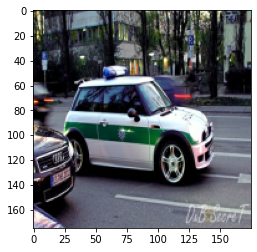

In [ ]:
# Displaying sample image from X_train and its corresponding label
plt.imshow(X_train[100])
print(y_train[100])

In [ ]:
# Showing its corresponding class label
for i in y_train[100]:
  print(class_names[i])

car


In [ ]:
# Converting X_train, X_test and X_val sets into type float
X_train = X_train.astype('float32')
X_val = X_val.astype('float32')
X_test = X_test.astype('float32')

In [ ]:
# Scaling the dataset

mean_image = np.mean(X_train, axis = 0)
X_train -= mean_image
X_val -= mean_image
X_test -= mean_image

In [ ]:
# Pre-processing the Train DataSet with ImageDataGenerator

datagen = ImageDataGenerator(
    width_shift_range=0.1,
    height_shift_range=0.1,
    horizontal_flip=True,
    vertical_flip=False,
    fill_mode="nearest")

datagen.fit(X_train)

In [ ]:
# Using Multilabel Binarizer

from sklearn.preprocessing import MultiLabelBinarizer

mlb = MultiLabelBinarizer()

y_train = mlb.fit_transform(y_train)
y_val = mlb.fit_transform(y_val)
y_test = mlb.fit_transform(y_test)

## Pre-Trained Model `InceptionV3`

In [ ]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
mdl = InceptionV3(weights='imagenet', include_top=False, input_shape=input_shape, pooling='max')
for layer in mdl.layers:
    layer.trainable = False  

87910968/87910968 [==============================] - 5s 0us/step


In [ ]:
x = mdl.output
x = Dense(1024, activation='relu')(x)
predictions = Dense(20, activation='sigmoid')(x)


In [ ]:
my_Model = Model(inputs=mdl.input, outputs=predictions, name='My_Model')
my_Model.summary()

Model: "My_Model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 175, 175, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 87, 87, 32)   864         ['input_1[0][0]']                
                                                                                                  
 batch_normalization (BatchNorm  (None, 87, 87, 32)  96          ['conv2d[0][0]']                 
 alization)                                                                                       
                                                                                           

In [ ]:
opt = tf.keras.optimizers.Adam(lr=0.001, decay=1e-6)
my_Model.compile(loss='binary_crossentropy',
                        optimizer=opt, metrics=['accuracy'])

batch_size = 512
epochs = 20
history = my_Model.fit_generator(datagen.flow(X_train, y_train, batch_size=batch_size),
                    epochs=epochs, validation_data=(X_val, y_val),shuffle=True)

/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)
<ipython-input-27-146cb016ce5c>:7: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = my_Model.fit_generator(datagen.flow(X_train, y_train, batch_size=batch_size),


Epoch 1/20
5/5 [==============================] - 46s 6s/step - loss: 19.3346 - accuracy: 0.0764 - val_loss: 18.6595 - val_accuracy: 0.0494
Epoch 2/20
5/5 [==============================] - 20s 4s/step - loss: 18.8985 - accuracy: 0.0796 - val_loss: 16.6631 - val_accuracy: 0.1251
Epoch 3/20
5/5 [==============================] - 19s 4s/step - loss: 14.6108 - accuracy: 0.0932 - val_loss: 11.6003 - val_accuracy: 0.0781
Epoch 4/20
5/5 [==============================] - 19s 4s/step - loss: 10.8240 - accuracy: 0.1156 - val_loss: 6.8694 - val_accuracy: 0.0996
Epoch 5/20
5/5 [==============================] - 19s 4s/step - loss: 7.1412 - accuracy: 0.0860 - val_loss: 4.8172 - val_accuracy: 0.1135
Epoch 6/20
5/5 [==============================] - 19s 4s/step - loss: 4.7306 - accuracy: 0.1355 - val_loss: 3.5228 - val_accuracy: 0.0896
Epoch 7/20
5/5 [==============================] - 20s 4s/step - loss: 3.4303 - accuracy: 0.1116 - val_loss: 2.5507 - val_accuracy: 0.1203
Epoch 8/20
5/5 [===========

In [ ]:
# calculte mean average precision from the model.history
def map_from_history(history):
    map = 0
    for i in range(len(history.history['val_accuracy'])):
        map += history.history['val_accuracy'][i]
    map /= len(history.history['val_accuracy'])
    return map

print("mean average precision:", map_from_history(history))

mean average precision: 0.11294820848852397


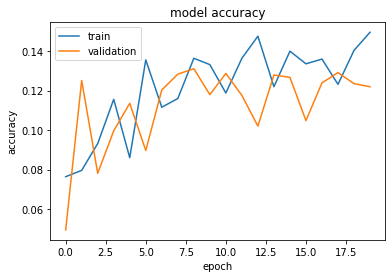

In [ ]:
# plot the training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')

plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

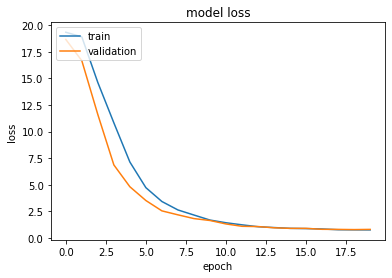

In [ ]:
# plot the training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
# evaluate the model
score = my_Model.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy: %.2f%%' % (score[1]*100))

Test loss: 0.7975050210952759
Test accuracy: 12.05%


In [ ]:
# predict the test data
y_pred = my_Model.predict(X_test)

63/63 [==============================] - 4s 46ms/step


X_test shape: (2000, 175, 175, 3)
y_test shape: (2000, 20)
y_pred shape: (2000, 20)
class_names shape: 20
class name: aeroplane
rank: 1688
predicted label: 0.9977418
true label: 0
Class name aeroplane


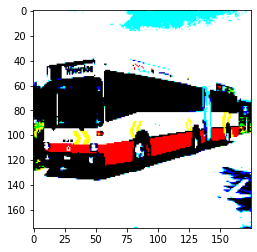

rank: 134
predicted label: 0.9979292
true label: 0
Class name aeroplane


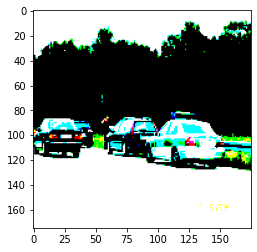

rank: 1395
predicted label: 0.9990225
true label: 0
Class name aeroplane


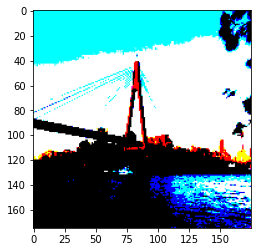

rank: 1686
predicted label: 0.999206
true label: 0
Class name aeroplane


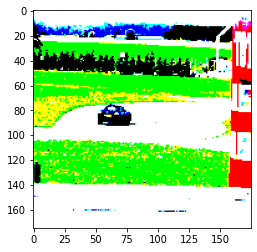

rank: 1272
predicted label: 0.9992399
true label: 0
Class name aeroplane


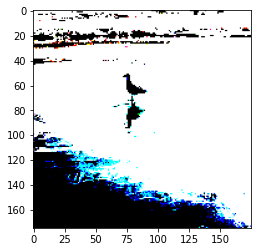

rank: 140
predicted label: 0.99949205
true label: 1
Class name aeroplane


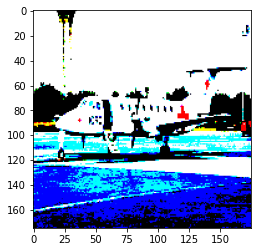

rank: 947
predicted label: 0.99971086
true label: 0
Class name aeroplane


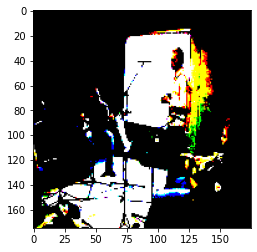

rank: 1177
predicted label: 0.999897
true label: 0
Class name aeroplane


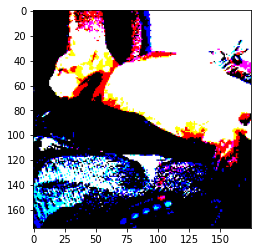

rank: 1571
predicted label: 0.99993825
true label: 0
Class name aeroplane


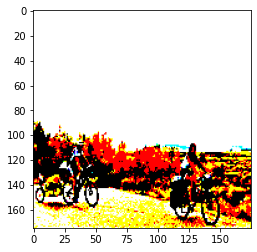

rank: 1089
predicted label: 0.9999865
true label: 0
Class name aeroplane


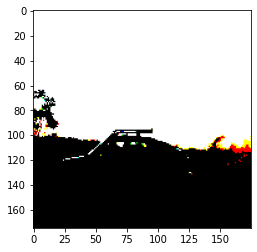

class name: bicycle
rank: 1187
predicted label: 0.73106784
true label: 0
Class name bicycle


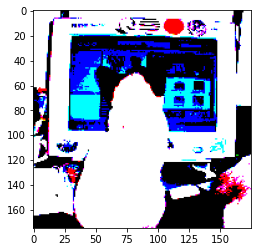

rank: 1112
predicted label: 0.73694074
true label: 0
Class name bicycle


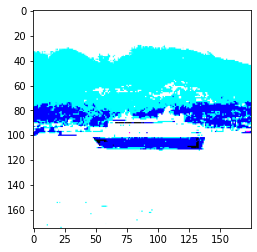

rank: 1731
predicted label: 0.7428566
true label: 0
Class name bicycle


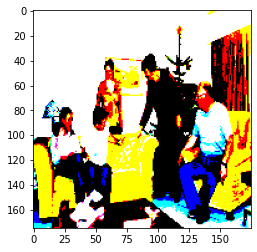

rank: 1194
predicted label: 0.80567
true label: 0
Class name bicycle


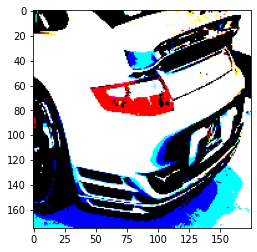

rank: 117
predicted label: 0.8779484
true label: 0
Class name bicycle


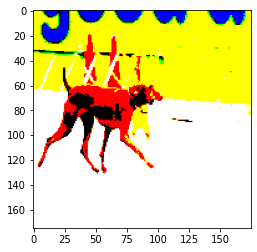

rank: 1575
predicted label: 0.8851809
true label: 0
Class name bicycle


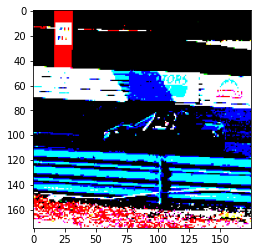

rank: 844
predicted label: 0.90877545
true label: 0
Class name bicycle


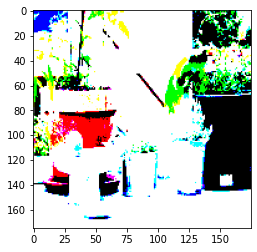

rank: 636
predicted label: 0.9423057
true label: 0
Class name bicycle


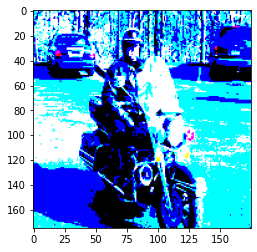

rank: 342
predicted label: 0.98777115
true label: 1
Class name bicycle


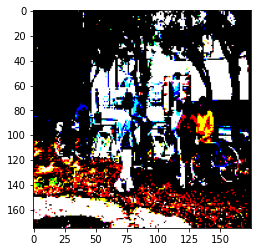

rank: 1615
predicted label: 0.9988564
true label: 1
Class name bicycle


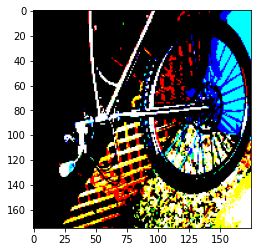

class name: bird
rank: 801
predicted label: 0.99998546
true label: 1
Class name bird


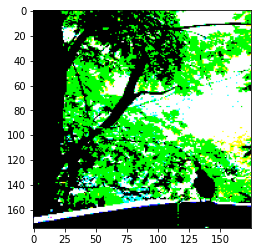

rank: 758
predicted label: 0.9999871
true label: 1
Class name bird


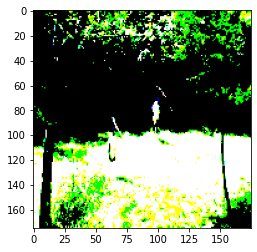

rank: 482
predicted label: 0.99998724
true label: 0
Class name bird


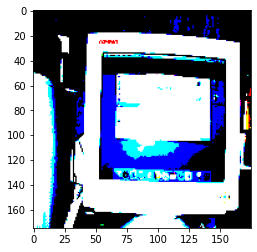

rank: 1323
predicted label: 0.99999464
true label: 1
Class name bird


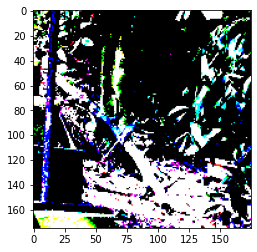

rank: 1381
predicted label: 0.99999547
true label: 0
Class name bird


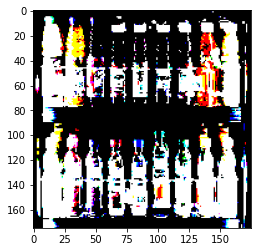

rank: 773
predicted label: 0.9999958
true label: 0
Class name bird


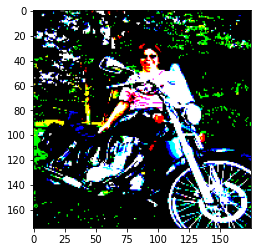

rank: 56
predicted label: 0.9999968
true label: 0
Class name bird


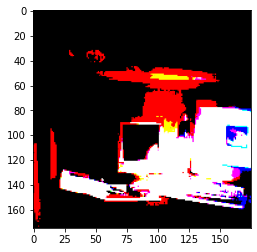

rank: 886
predicted label: 0.99999857
true label: 0
Class name bird


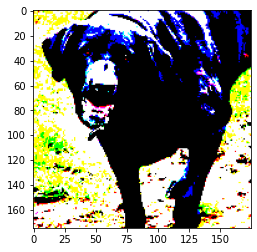

rank: 1174
predicted label: 0.99999976
true label: 1
Class name bird


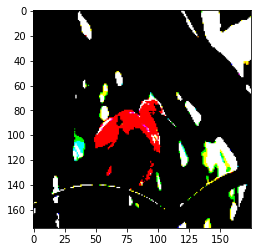

rank: 1483
predicted label: 1.0
true label: 0
Class name bird


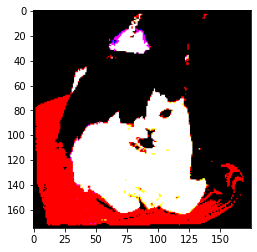

class name: boat
rank: 1368
predicted label: 0.98218703
true label: 0
Class name boat


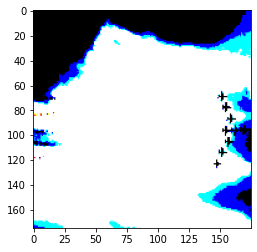

rank: 119
predicted label: 0.98378146
true label: 0
Class name boat


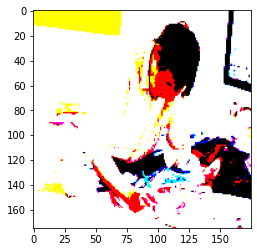

rank: 1115
predicted label: 0.9852357
true label: 0
Class name boat


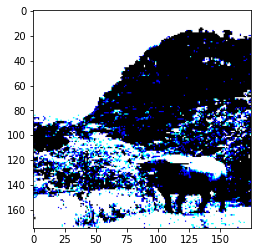

rank: 1808
predicted label: 0.99118596
true label: 0
Class name boat


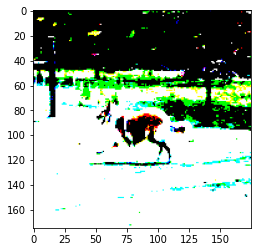

rank: 763
predicted label: 0.9915569
true label: 0
Class name boat


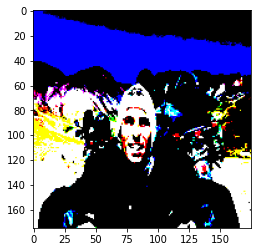

rank: 543
predicted label: 0.9975394
true label: 0
Class name boat


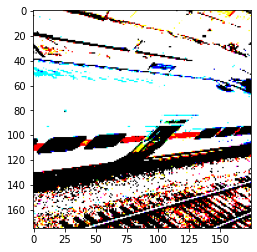

rank: 1706
predicted label: 0.9977494
true label: 0
Class name boat


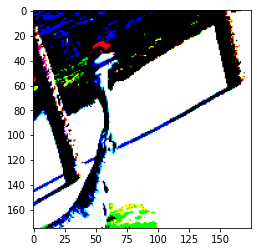

rank: 398
predicted label: 0.9994949
true label: 0
Class name boat


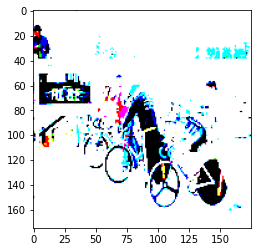

rank: 794
predicted label: 0.9996904
true label: 0
Class name boat


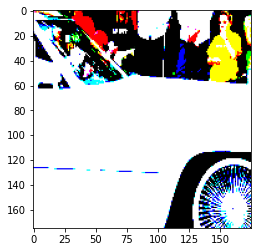

rank: 977
predicted label: 0.9999994
true label: 0
Class name boat


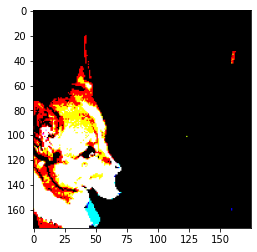

class name: bottle
rank: 1258
predicted label: 0.9999554
true label: 0
Class name bottle


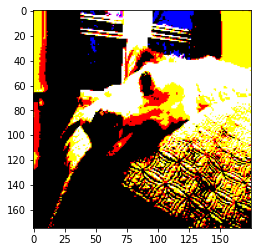

rank: 283
predicted label: 0.99996614
true label: 0
Class name bottle


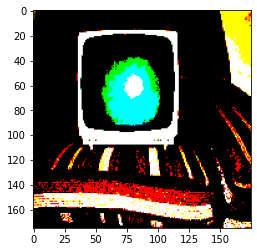

rank: 60
predicted label: 0.99997425
true label: 0
Class name bottle


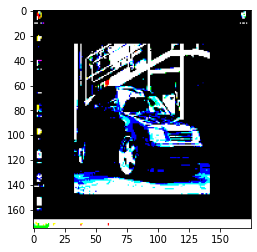

rank: 670
predicted label: 0.9999896
true label: 0
Class name bottle


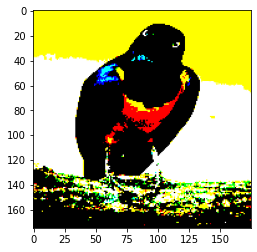

rank: 1110
predicted label: 0.9999945
true label: 0
Class name bottle


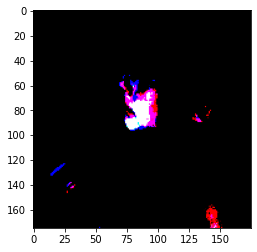

rank: 678
predicted label: 0.9999962
true label: 0
Class name bottle


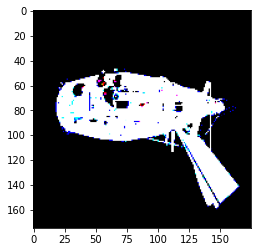

rank: 98
predicted label: 0.9999988
true label: 0
Class name bottle


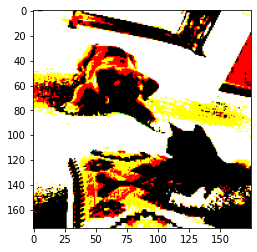

rank: 1324
predicted label: 0.9999993
true label: 0
Class name bottle


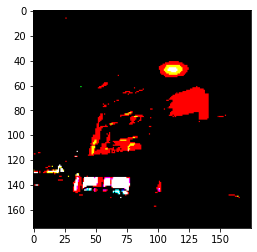

rank: 1690
predicted label: 0.99999976
true label: 0
Class name bottle


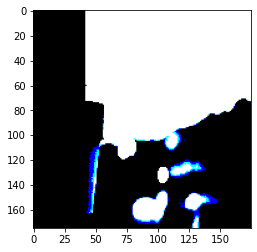

rank: 1370
predicted label: 0.9999999
true label: 0
Class name bottle


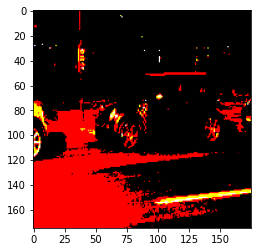

class name: bus
rank: 1667
predicted label: 0.998792
true label: 0
Class name bus


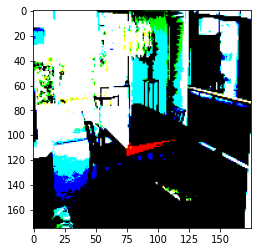

rank: 926
predicted label: 0.99883884
true label: 0
Class name bus


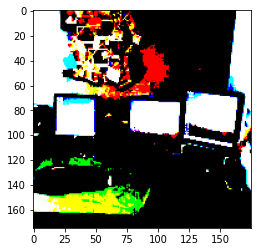

rank: 11
predicted label: 0.99902046
true label: 1
Class name bus


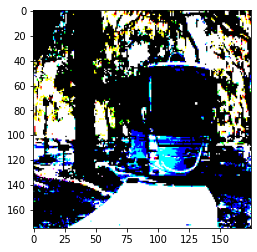

rank: 1062
predicted label: 0.9992555
true label: 0
Class name bus


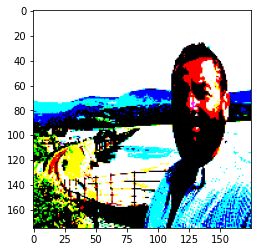

rank: 923
predicted label: 0.9992741
true label: 0
Class name bus


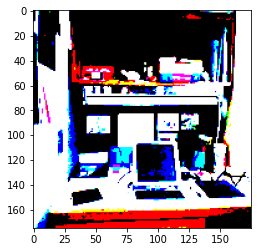

rank: 766
predicted label: 0.99943024
true label: 0
Class name bus


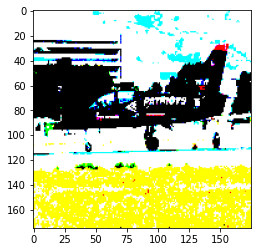

rank: 1630
predicted label: 0.99992764
true label: 0
Class name bus


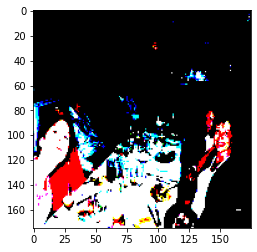

rank: 1225
predicted label: 0.9999529
true label: 0
Class name bus


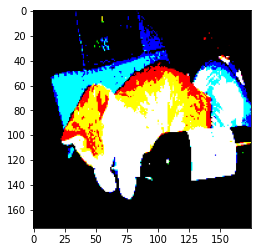

rank: 1069
predicted label: 0.99999785
true label: 0
Class name bus


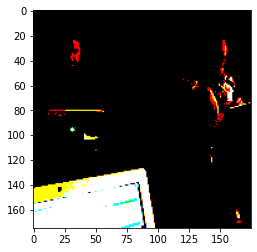

rank: 1070
predicted label: 0.9999981
true label: 0
Class name bus


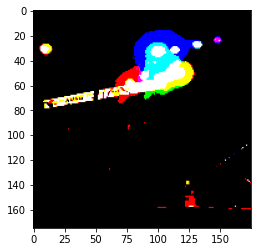

class name: car
rank: 268
predicted label: 0.98597324
true label: 0
Class name car


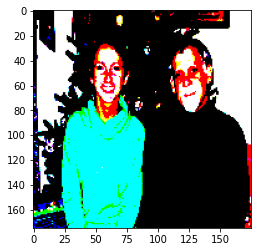

rank: 986
predicted label: 0.98950315
true label: 1
Class name car


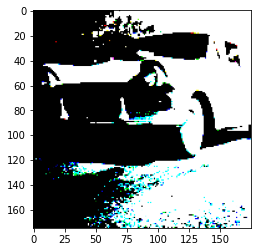

rank: 1955
predicted label: 0.99151707
true label: 1
Class name car


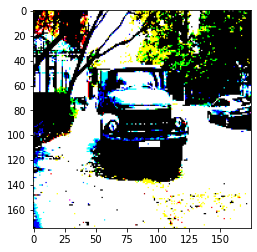

rank: 1642
predicted label: 0.99289036
true label: 0
Class name car


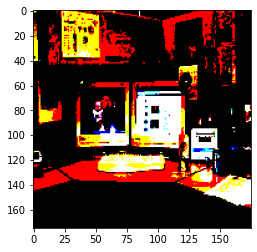

rank: 1581
predicted label: 0.9929489
true label: 1
Class name car


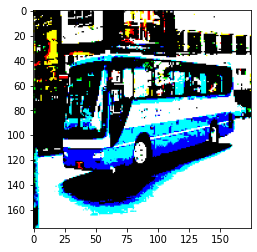

rank: 513
predicted label: 0.9930797
true label: 1
Class name car


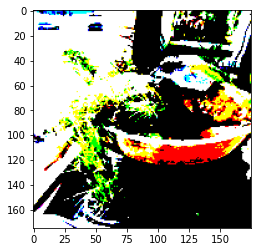

rank: 1290
predicted label: 0.9963457
true label: 0
Class name car


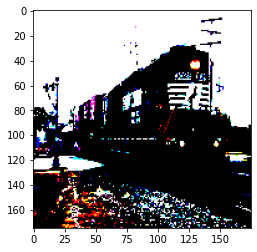

rank: 304
predicted label: 0.9977718
true label: 1
Class name car


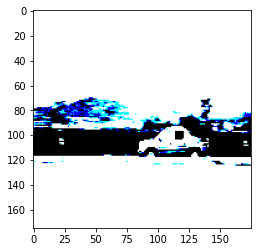

rank: 1764
predicted label: 0.99839336
true label: 0
Class name car


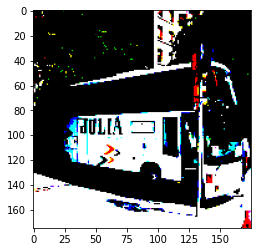

rank: 392
predicted label: 0.99918324
true label: 0
Class name car


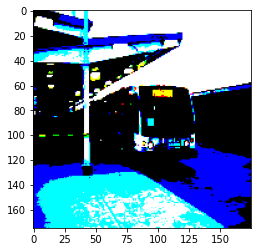

class name: cat
rank: 126
predicted label: 0.9823898
true label: 0
Class name cat


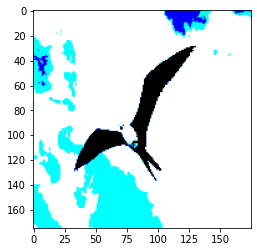

rank: 810
predicted label: 0.9877367
true label: 0
Class name cat


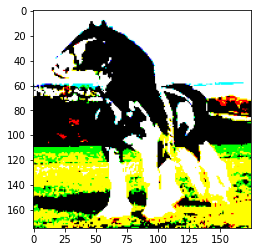

rank: 482
predicted label: 0.99025893
true label: 0
Class name cat


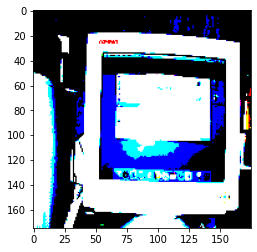

rank: 1245
predicted label: 0.9954602
true label: 0
Class name cat


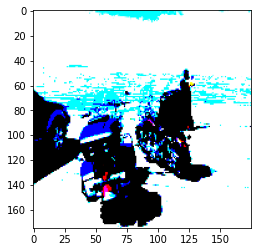

rank: 1873
predicted label: 0.99625754
true label: 0
Class name cat


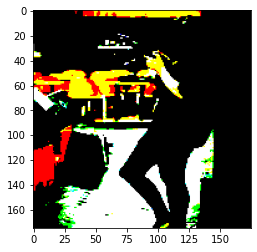

rank: 1110
predicted label: 0.99809855
true label: 0
Class name cat


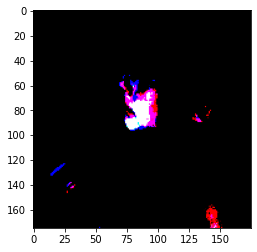

rank: 751
predicted label: 0.9984144
true label: 0
Class name cat


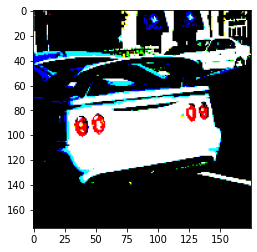

rank: 288
predicted label: 0.9995648
true label: 0
Class name cat


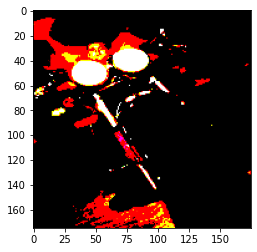

rank: 1510
predicted label: 0.9998846
true label: 1
Class name cat


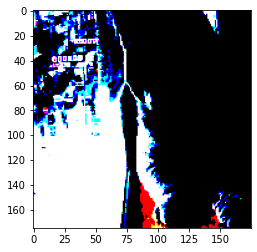

rank: 129
predicted label: 1.0
true label: 1
Class name cat


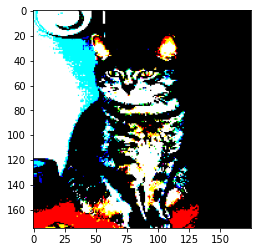

class name: chair
rank: 977
predicted label: 1.0
true label: 0
Class name chair


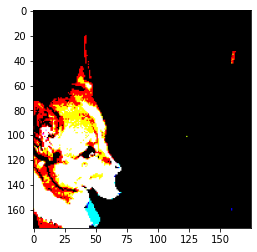

rank: 424
predicted label: 1.0
true label: 0
Class name chair


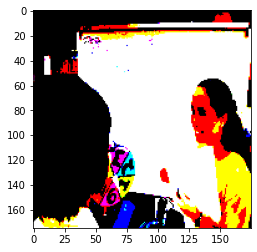

rank: 1732
predicted label: 1.0
true label: 0
Class name chair


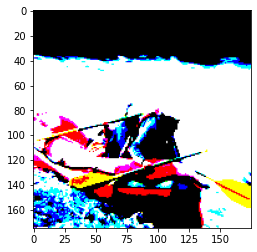

rank: 232
predicted label: 1.0
true label: 0
Class name chair


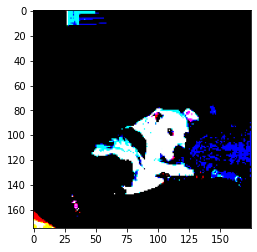

rank: 1982
predicted label: 1.0
true label: 1
Class name chair


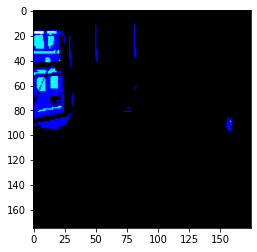

rank: 401
predicted label: 1.0
true label: 0
Class name chair


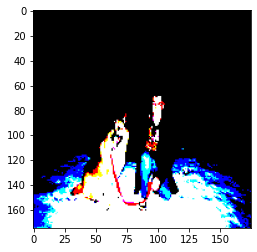

rank: 1333
predicted label: 1.0
true label: 0
Class name chair


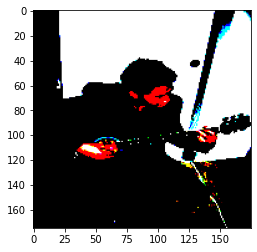

rank: 1590
predicted label: 1.0
true label: 0
Class name chair


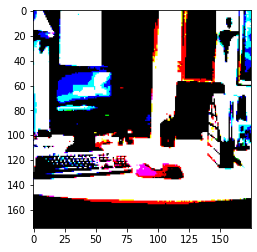

rank: 845
predicted label: 1.0
true label: 0
Class name chair


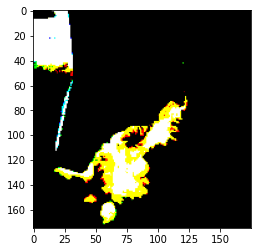

rank: 1449
predicted label: 1.0
true label: 1
Class name chair


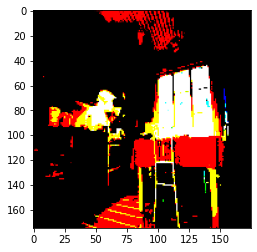

class name: cow
rank: 1036
predicted label: 0.7557429
true label: 0
Class name cow


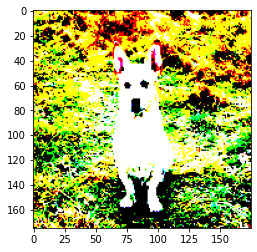

rank: 909
predicted label: 0.77730775
true label: 0
Class name cow


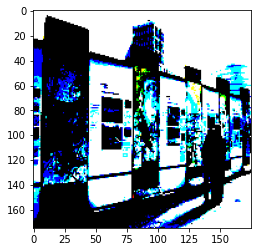

rank: 1525
predicted label: 0.78363156
true label: 0
Class name cow


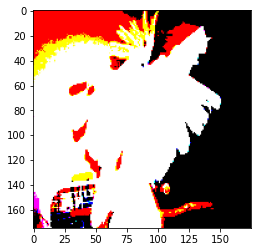

rank: 932
predicted label: 0.8248223
true label: 0
Class name cow


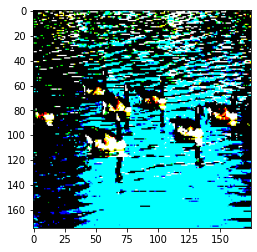

rank: 307
predicted label: 0.83368015
true label: 0
Class name cow


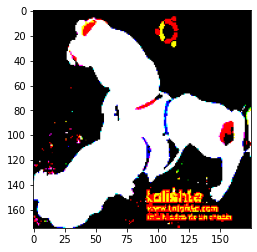

rank: 342
predicted label: 0.9059234
true label: 0
Class name cow


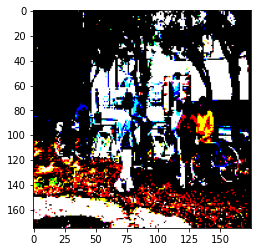

rank: 1342
predicted label: 0.94032156
true label: 0
Class name cow


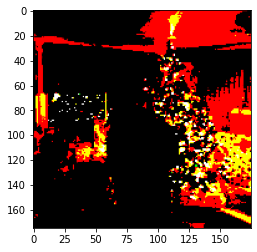

rank: 1883
predicted label: 0.9725955
true label: 0
Class name cow


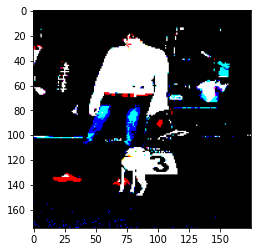

rank: 801
predicted label: 0.99012685
true label: 0
Class name cow


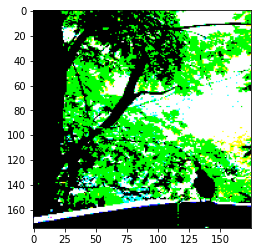

rank: 1070
predicted label: 0.9999987
true label: 0
Class name cow


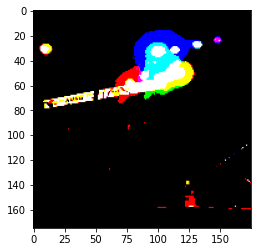

class name: diningtable
rank: 1271
predicted label: 0.998456
true label: 0
Class name diningtable


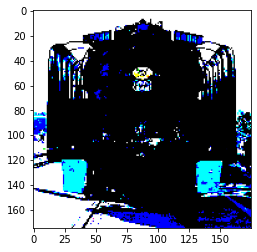

rank: 1382
predicted label: 0.99886394
true label: 0
Class name diningtable


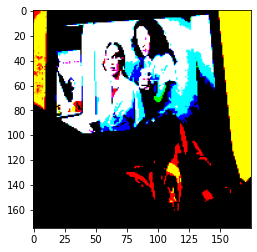

rank: 671
predicted label: 0.99900395
true label: 0
Class name diningtable


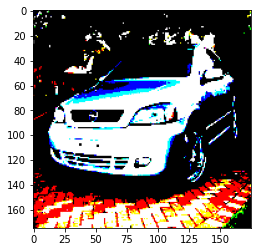

rank: 1370
predicted label: 0.9992249
true label: 0
Class name diningtable


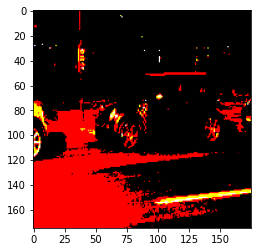

rank: 651
predicted label: 0.9994272
true label: 0
Class name diningtable


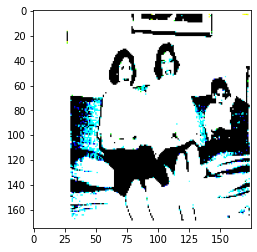

rank: 782
predicted label: 0.9995741
true label: 1
Class name diningtable


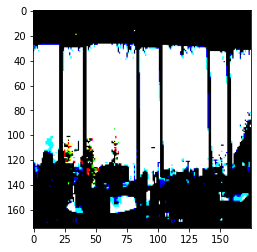

rank: 1942
predicted label: 0.99973863
true label: 1
Class name diningtable


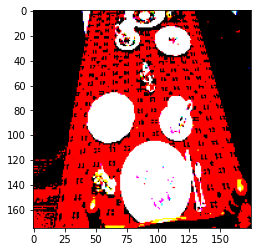

rank: 420
predicted label: 0.9998448
true label: 0
Class name diningtable


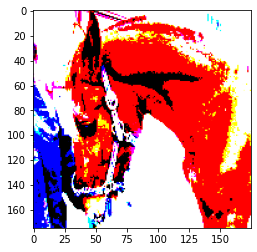

rank: 1791
predicted label: 0.99988854
true label: 0
Class name diningtable


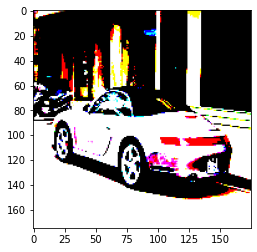

rank: 1997
predicted label: 0.9999683
true label: 0
Class name diningtable


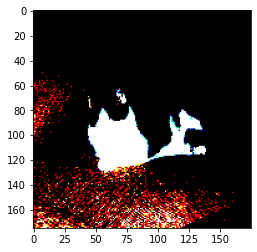

class name: dog
rank: 1644
predicted label: 0.8675076
true label: 0
Class name dog


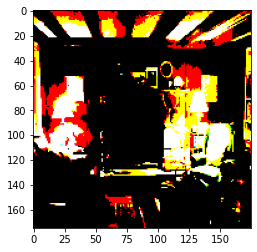

rank: 1213
predicted label: 0.9628069
true label: 0
Class name dog


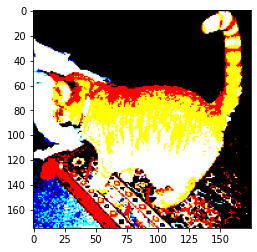

rank: 1250
predicted label: 0.97707486
true label: 0
Class name dog


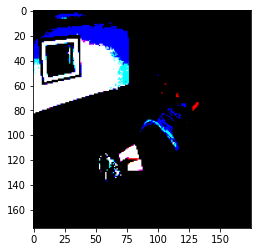

rank: 199
predicted label: 0.979863
true label: 0
Class name dog


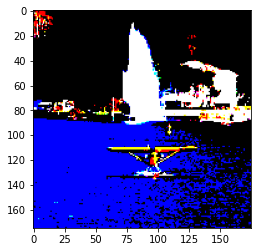

rank: 1305
predicted label: 0.98339176
true label: 1
Class name dog


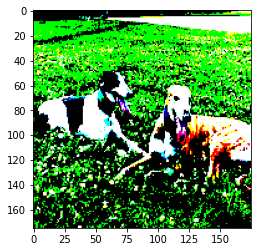

rank: 829
predicted label: 0.9883243
true label: 0
Class name dog


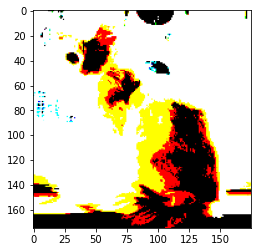

rank: 1179
predicted label: 0.99430794
true label: 0
Class name dog


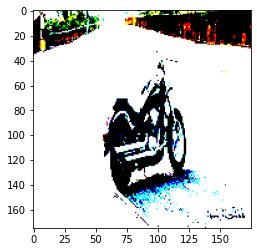

rank: 1352
predicted label: 0.99770135
true label: 0
Class name dog


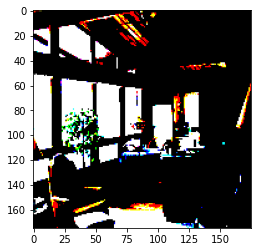

rank: 1294
predicted label: 0.9990387
true label: 0
Class name dog


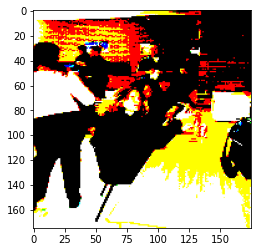

rank: 1373
predicted label: 0.9996449
true label: 0
Class name dog


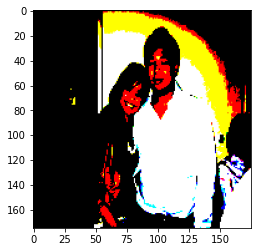

class name: horse
rank: 1323
predicted label: 0.9976744
true label: 0
Class name horse


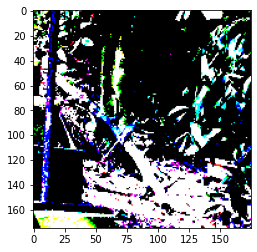

rank: 212
predicted label: 0.99804676
true label: 0
Class name horse


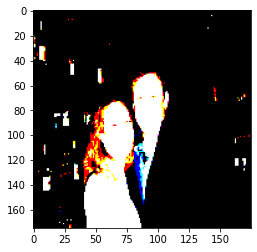

rank: 147
predicted label: 0.99847835
true label: 0
Class name horse


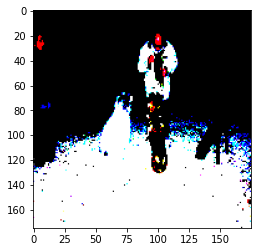

rank: 758
predicted label: 0.9994808
true label: 0
Class name horse


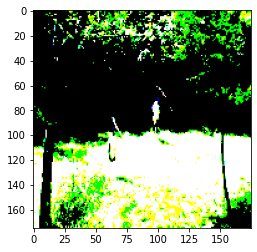

rank: 1912
predicted label: 0.9996393
true label: 0
Class name horse


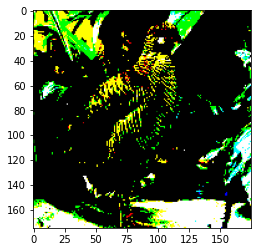

rank: 194
predicted label: 0.9996538
true label: 0
Class name horse


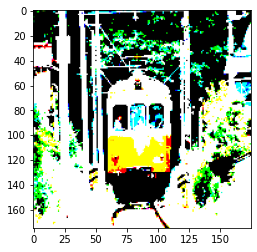

rank: 1917
predicted label: 0.9998692
true label: 0
Class name horse


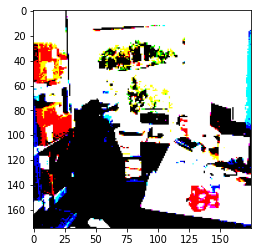

rank: 1946
predicted label: 0.9998913
true label: 0
Class name horse


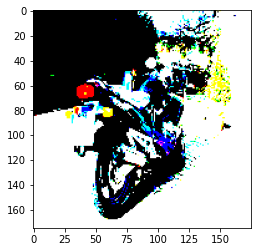

rank: 1220
predicted label: 0.999913
true label: 0
Class name horse


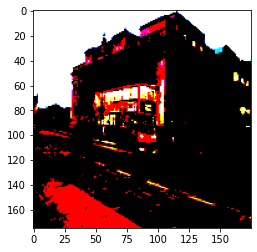

rank: 540
predicted label: 0.9999776
true label: 0
Class name horse


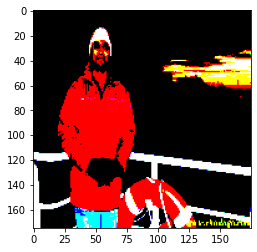

class name: motorbike
rank: 1942
predicted label: 0.9797474
true label: 0
Class name motorbike


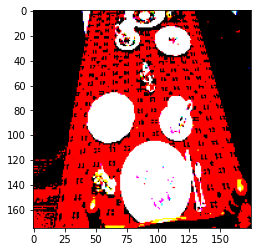

rank: 1554
predicted label: 0.98330164
true label: 0
Class name motorbike


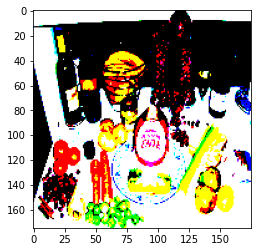

rank: 1334
predicted label: 0.986316
true label: 0
Class name motorbike


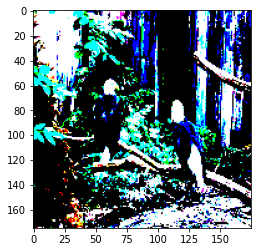

rank: 193
predicted label: 0.99059314
true label: 0
Class name motorbike


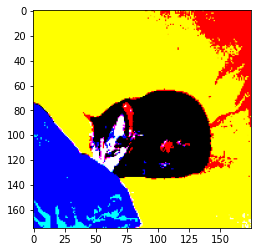

rank: 1492
predicted label: 0.9924286
true label: 0
Class name motorbike


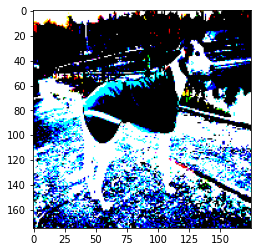

rank: 393
predicted label: 0.9965731
true label: 0
Class name motorbike


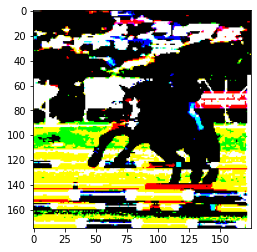

rank: 1006
predicted label: 0.9997261
true label: 0
Class name motorbike


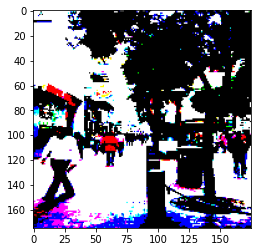

rank: 947
predicted label: 0.9999634
true label: 0
Class name motorbike


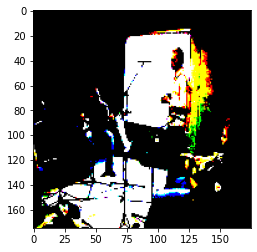

rank: 1524
predicted label: 0.99997044
true label: 0
Class name motorbike


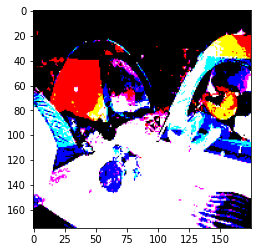

rank: 46
predicted label: 0.9999993
true label: 0
Class name motorbike


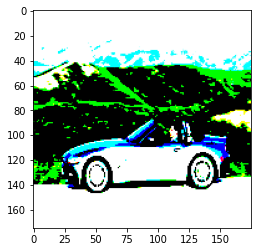

class name: person
rank: 292
predicted label: 1.0
true label: 1
Class name person


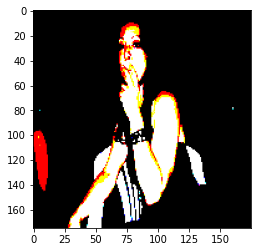

rank: 1020
predicted label: 1.0
true label: 1
Class name person


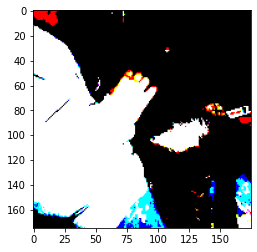

rank: 1469
predicted label: 1.0
true label: 0
Class name person


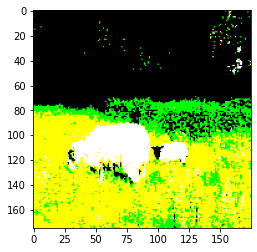

rank: 1846
predicted label: 1.0
true label: 0
Class name person


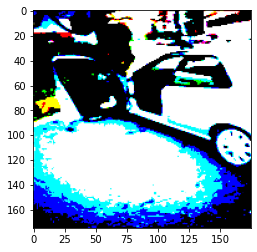

rank: 1616
predicted label: 1.0
true label: 1
Class name person


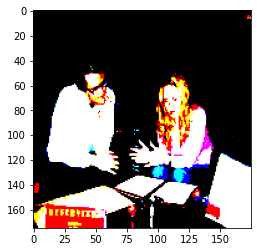

rank: 387
predicted label: 1.0
true label: 0
Class name person


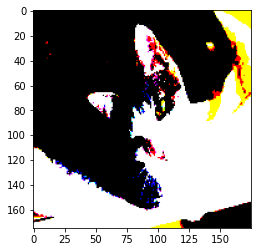

rank: 1824
predicted label: 1.0
true label: 1
Class name person


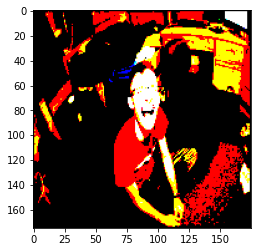

rank: 950
predicted label: 1.0
true label: 1
Class name person


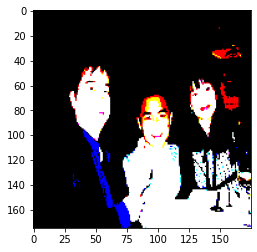

rank: 1071
predicted label: 1.0
true label: 0
Class name person


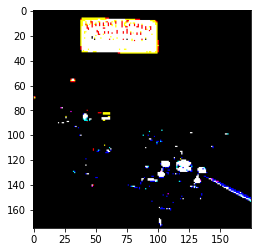

rank: 1716
predicted label: 1.0
true label: 0
Class name person


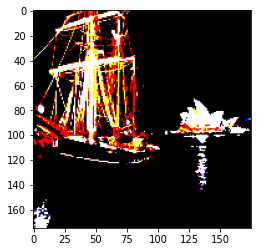

class name: pottedplant
rank: 826
predicted label: 0.99214655
true label: 1
Class name pottedplant


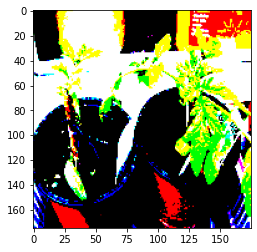

rank: 1906
predicted label: 0.9931178
true label: 0
Class name pottedplant


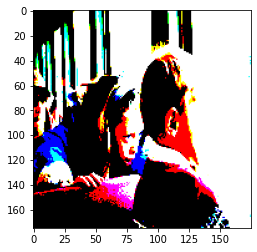

rank: 171
predicted label: 0.9933274
true label: 0
Class name pottedplant


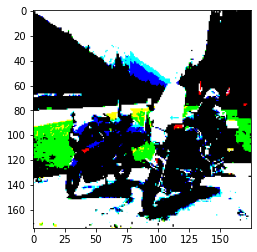

rank: 1321
predicted label: 0.9983273
true label: 0
Class name pottedplant


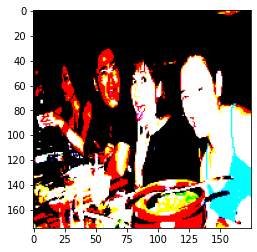

rank: 1459
predicted label: 0.9987716
true label: 0
Class name pottedplant


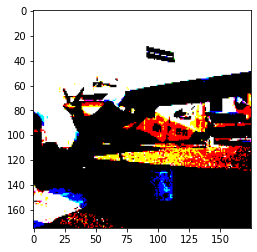

rank: 1433
predicted label: 0.99877197
true label: 0
Class name pottedplant


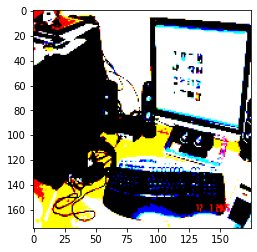

rank: 360
predicted label: 0.99900085
true label: 0


Class name pottedplant


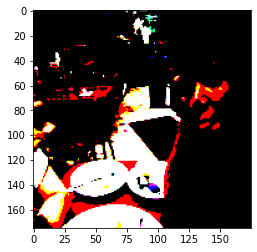

rank: 606
predicted label: 0.99912304
true label: 0
Class name pottedplant


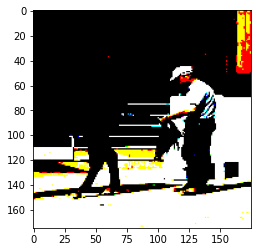

rank: 568
predicted label: 0.99962604
true label: 0
Class name pottedplant


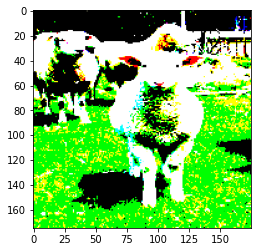

rank: 1073
predicted label: 0.9996668
true label: 0


Class name pottedplant


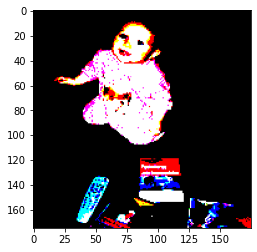

class name: sheep
rank: 272
predicted label: 0.98590845
true label: 0
Class name sheep


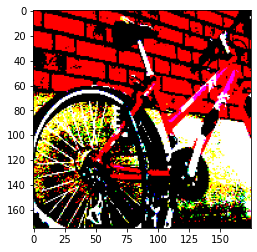

rank: 1524
predicted label: 0.987978
true label: 0
Class name sheep


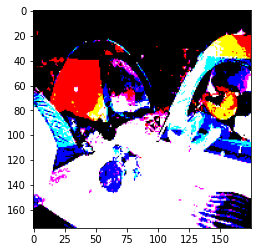

rank: 265
predicted label: 0.99671054
true label: 0
Class name sheep


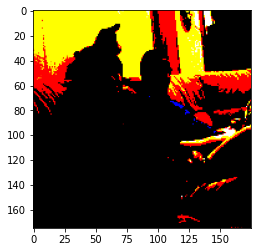

rank: 1293
predicted label: 0.99674916
true label: 1
Class name sheep


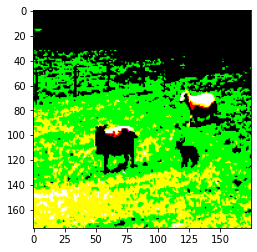

rank: 615
predicted label: 0.9967751
true label: 0
Class name sheep


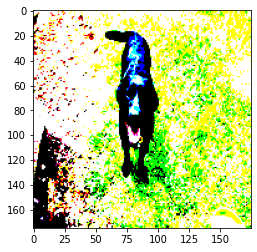

rank: 1057
predicted label: 0.9982691
true label: 0
Class name sheep


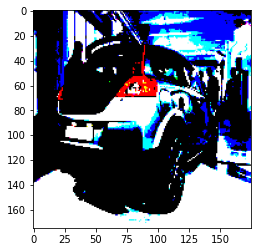

rank: 757
predicted label: 0.9982754
true label: 0
Class name sheep


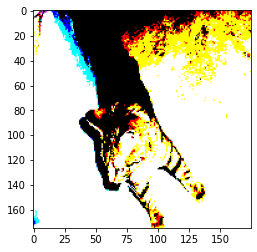

rank: 1474
predicted label: 0.99845064
true label: 0
Class name sheep


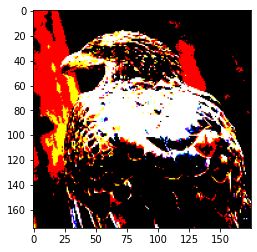

rank: 1453
predicted label: 0.9991302
true label: 0
Class name sheep


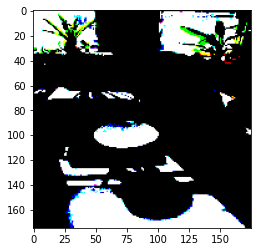

rank: 1346
predicted label: 0.9995499
true label: 0
Class name sheep


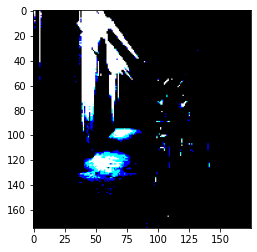

class name: sofa
rank: 1201
predicted label: 0.9995499
true label: 0
Class name sofa


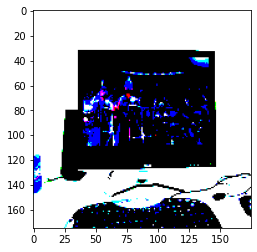

rank: 827
predicted label: 0.9996264
true label: 0
Class name sofa


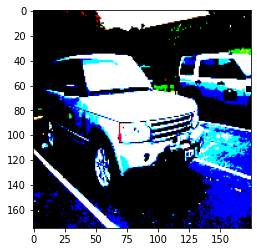

rank: 1069
predicted label: 0.99963534
true label: 1
Class name sofa


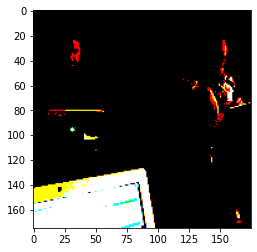

rank: 1016
predicted label: 0.99969757
true label: 0
Class name sofa


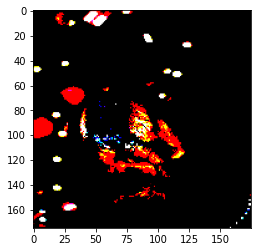

rank: 1590
predicted label: 0.9998217
true label: 0
Class name sofa


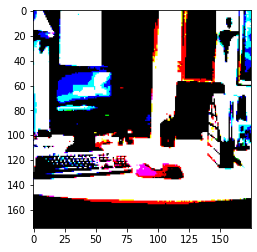

rank: 1989
predicted label: 0.99992657
true label: 0
Class name

 sofa


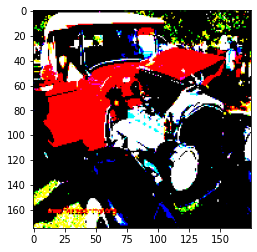

rank: 1499
predicted label: 0.9999281
true label: 0
Class name sofa


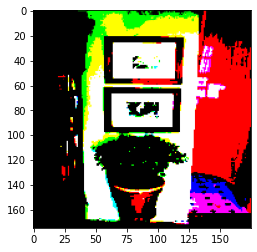

rank: 963
predicted label: 0.9999527
true label: 0
Class name sofa


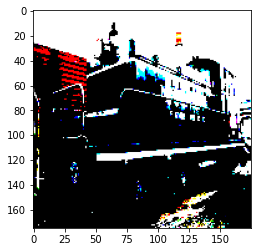

rank: 1047
predicted label: 0.9999534
true label: 0
Class name sofa


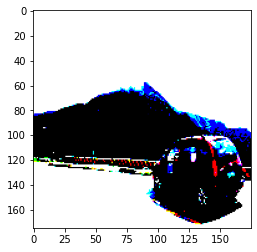

rank: 1374
predicted label: 0.9999622
true label: 0
Class name sofa


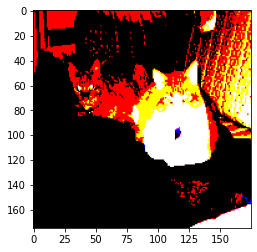

class name: train
rank: 1207
predicted label: 0.9047536
true label: 0
Class name train


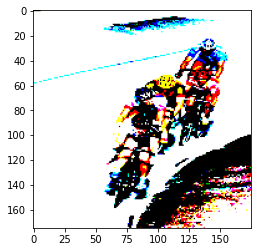

rank: 1924
predicted label: 0.9078224
true label: 0
Class name train


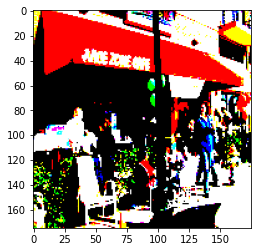

rank:

 683
predicted label: 0.91639453
true label: 0
Class name train


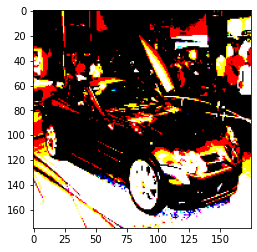

rank: 149
predicted label: 0.9487202
true label: 1
Class name train


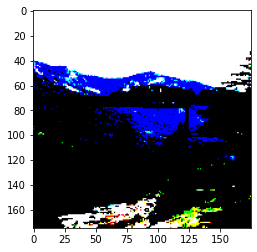

rank: 1443
predicted label: 0.95730245
true label: 0
Class name train


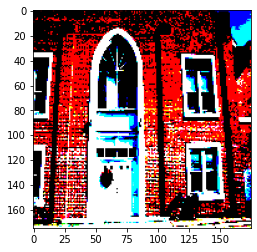

rank: 1231


predicted label: 0.9605431
true label: 0
Class name train


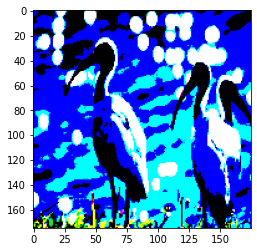

rank: 1271
predicted label: 0.99689925
true label: 1
Class name train


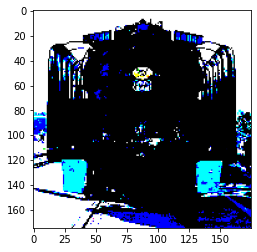

rank: 1004
predicted label: 0.9973022
true label: 0
Class name train


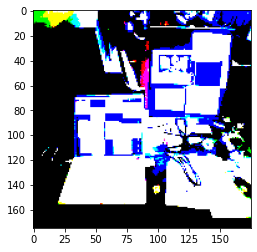

rank: 372
predicted label: 0.99904376
true label: 1
Class name train


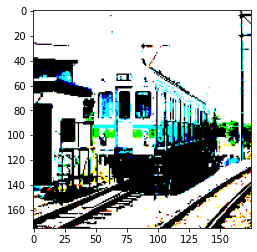

rank: 1531
predicted label: 0.9999639
true label: 0
Class name train


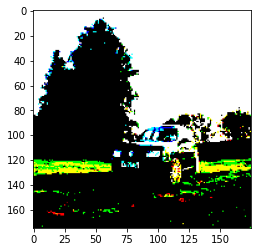

class name: tvmonitor
rank: 355
predicted label: 0.99988663
true label: 0
Class name tvmonitor


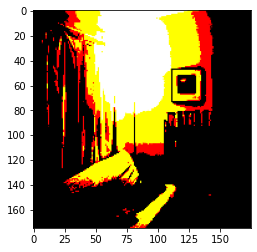

rank: 1113
predicted label: 0.99991393
true label: 1
Class name tvmonitor


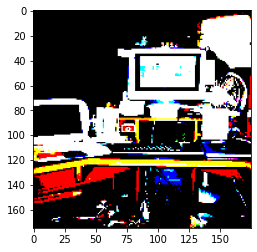

rank: 98
predicted label: 0.99993587
true label: 0
Class name tvmonitor


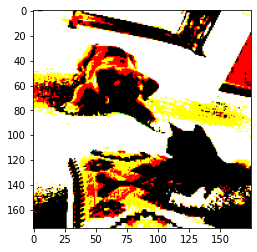

rank: 549
predicted label: 0.9999511
true label: 0
Class name tvmonitor


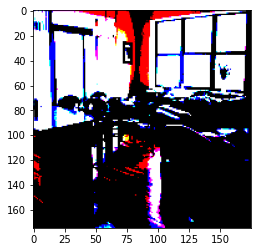

rank: 1596
predicted label: 0.9999691
true label: 1
Class name tvmonitor


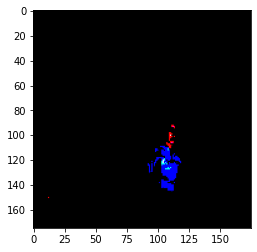

rank: 97
predicted label: 0.9999876
true label: 1
Class name tvmonitor


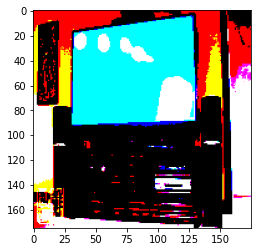

rank: 1642
predicted label: 0.99998987
true label: 1
Class name tvmonitor


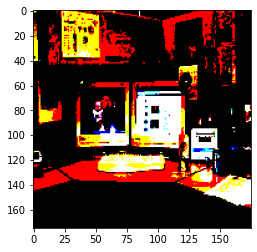

rank: 1211
predicted label: 0.9999943
true label: 0
Class name tvmonitor


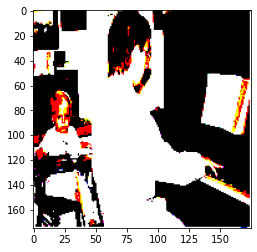

rank: 1457
predicted label: 0.99999964
true label: 0
Class name tvmonitor


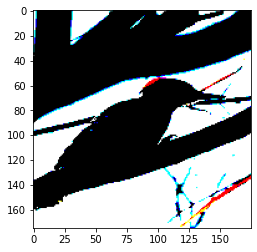

rank: 892
predicted label: 0.9999999
true label: 0
Class name tvmonitor


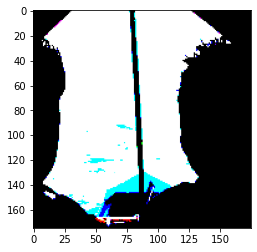

In [ ]:
# show the top 10 ranked photos for each class

def show_top10_ranked_photos(X_test, y_test, y_pred, class_names):
    y_pred = np.asarray(y_pred)
    y_test = np.asarray(y_test)
    X_test = np.asarray(X_test)
    print("X_test shape:", X_test.shape)
    print("y_test shape:", y_test.shape)
    print("y_pred shape:", y_pred.shape)
    print("class_names shape:", len(class_names))
    for i in range(20):
        print("class name:", class_names[i])
        # get the top 10 ranked photos
        top10 = np.argsort(y_pred[:, i])[-10:]
        for j in top10:
            print("rank:", j)
            print("predicted label:", y_pred[j, i])
            print("true label:", y_test[j, i])
            print("Class name", class_names[i])
            plt.imshow(X_test[j])
            plt.show()

show_top10_ranked_photos(X_test, y_test, y_pred, class_names)

## Pre-Trained Model `VGG-16`

In [ ]:
from tensorflow.keras.applications.vgg16 import VGG16
mdl = VGG16(weights='imagenet', include_top=False, input_shape=input_shape, pooling='max')
for layer in mdl.layers:
    layer.trainable = False  

58889256/58889256 [==============================] - 3s 0us/step


In [ ]:
x = mdl.output
x = Dense(1024, activation='relu')(x)
predictions = Dense(20, activation='sigmoid')(x)


In [ ]:
my_Model = Model(inputs=mdl.input, outputs=predictions, name='My_Model')
my_Model.summary()

Model: "My_Model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 175, 175, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 175, 175, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 175, 175, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 87, 87, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 87, 87, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 87, 87, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 43, 43, 128)       0  

In [ ]:
opt = tf.keras.optimizers.Adam(lr=0.001, decay=1e-6)
my_Model.compile(loss='binary_crossentropy',
                        optimizer=opt, metrics=['accuracy'])

batch_size = 512
epochs = 20
history = my_Model.fit_generator(datagen.flow(X_train, y_train, batch_size=batch_size),
                    epochs=epochs, validation_data=(X_val, y_val),shuffle=True)

<ipython-input-37-146cb016ce5c>:7: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = my_Model.fit_generator(datagen.flow(X_train, y_train, batch_size=batch_size),


Epoch 1/20
5/5 [==============================] - 87s 14s/step - loss: 3.7150 - accuracy: 0.1311 - val_loss: 3.3456 - val_accuracy: 0.2474
Epoch 2/20
5/5 [==============================] - 25s 5s/step - loss: 2.5364 - accuracy: 0.2939 - val_loss: 2.1872 - val_accuracy: 0.3645
Epoch 3/20
5/5 [==============================] - 26s 5s/step - loss: 1.6220 - accuracy: 0.3739 - val_loss: 1.4611 - val_accuracy: 0.4068
Epoch 4/20
5/5 [==============================] - 28s 6s/step - loss: 0.9949 - accuracy: 0.4346 - val_loss: 0.9487 - val_accuracy: 0.4414
Epoch 5/20
5/5 [==============================] - 26s 5s/step - loss: 0.6714 - accuracy: 0.4482 - val_loss: 0.7308 - val_accuracy: 0.4546
Epoch 6/20
5/5 [==============================] - 26s 5s/step - loss: 0.5362 - accuracy: 0.4822 - val_loss: 0.6466 - val_accuracy: 0.4769
Epoch 7/20
5/5 [==============================] - 25s 5s/step - loss: 0.4115 - accuracy: 0.5094 - val_loss: 0.5190 - val_accuracy: 0.4729
Epoch 8/20
5/5 [=================

In [ ]:
# calculte mean average precision from the model.history
def map_from_history(history):
    map = 0
    for i in range(len(history.history['val_accuracy'])):
        map += history.history['val_accuracy'][i]
    map /= len(history.history['val_accuracy'])
    return map

print("mean average precision:", map_from_history(history))

mean average precision: 0.46095617711544035


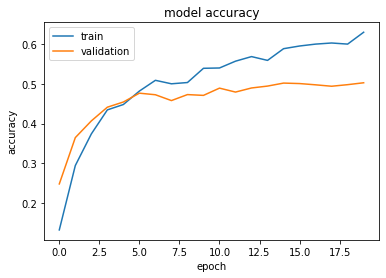

In [ ]:
# plot the training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')

plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

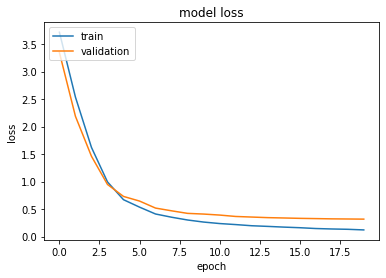

In [ ]:
# plot the training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
# evaluate the model
score = my_Model.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy: %.2f%%' % (score[1]*100))

Test loss: 0.30818912386894226
Test accuracy: 53.30%


In [ ]:
# predict the test data
y_pred = my_Model.predict(X_test)

63/63 [==============================] - 6s 102ms/step


X_test shape: (2000, 175, 175, 3)
y_test shape: (2000, 20)
y_pred shape: (2000, 20)
class_names shape: 20
class name: aeroplane
rank: 1541
predicted label: 1.0
true label: 1
Class name aeroplane


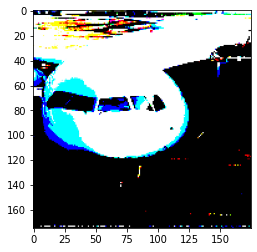

rank: 1544
predicted label: 1.0
true label: 1
Class name aeroplane


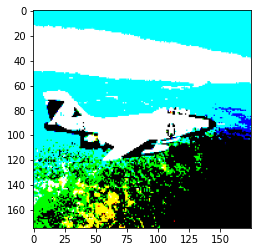

rank: 1330
predicted label: 1.0
true label: 1
Class name aeroplane


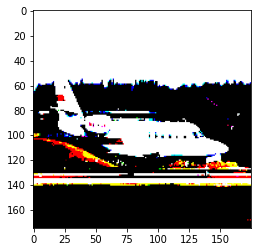

rank: 1754
predicted label: 1.0
true label: 1
Class name aeroplane


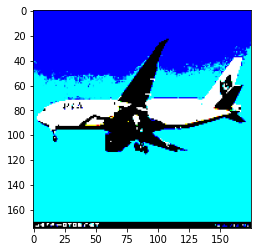

rank: 618
predicted label: 1.0
true label: 1
Class name aeroplane


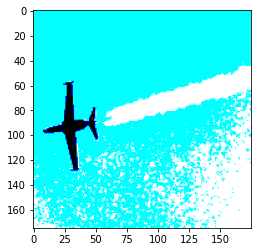

rank: 658
predicted label: 1.0
true label: 1
Class name aeroplane


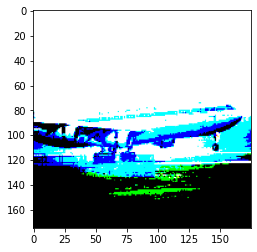

rank: 1614
predicted label: 1.0
true label: 0
Class name aeroplane


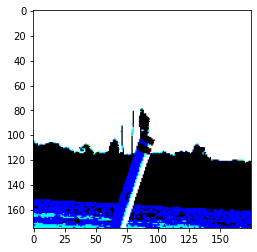

rank: 47
predicted label: 1.0
true label: 1
Class name aeroplane


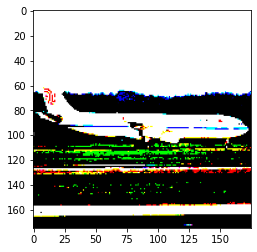

rank: 1935
predicted label: 1.0
true label: 1
Class name aeroplane


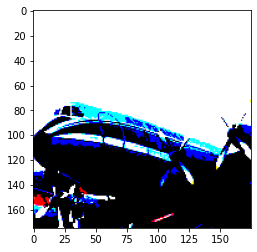

rank: 1719
predicted label: 1.0
true label: 1
Class name aeroplane


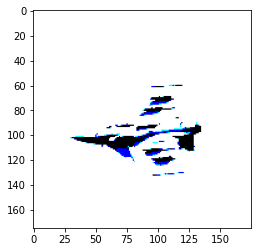

class name: bicycle
rank: 1397
predicted label: 1.0
true label: 1
Class name bicycle


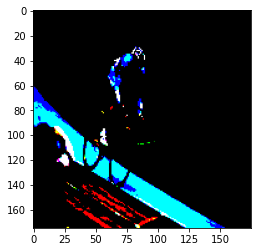

rank: 365
predicted label: 1.0
true label: 1
Class name bicycle


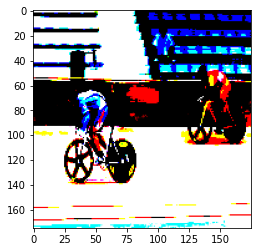

rank: 1773
predicted label: 1.0
true label: 1
Class name bicycle


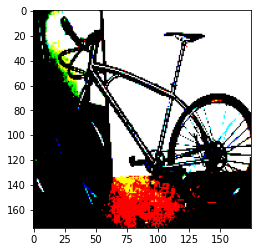

rank: 861
predicted label: 1.0
true label: 1
Class name bicycle


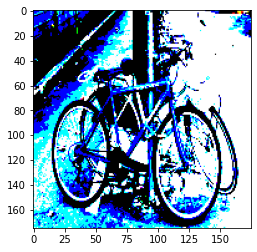

rank: 1249
predicted label: 1.0
true label: 1
Class name bicycle


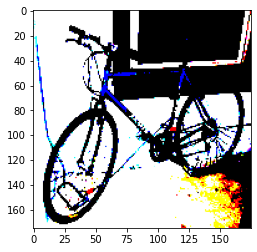

rank: 1243
predicted label: 1.0
true label: 1
Class name bicycle


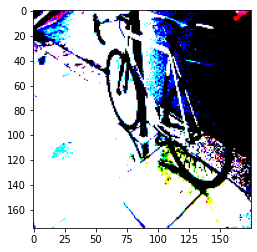

rank: 617
predicted label: 1.0
true label: 1
Class name bicycle


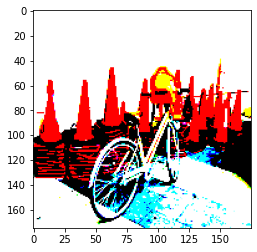

rank: 48
predicted label: 1.0
true label: 1
Class name bicycle


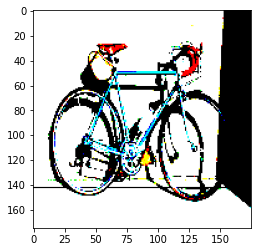

rank: 431
predicted label: 1.0
true label: 1
Class name bicycle


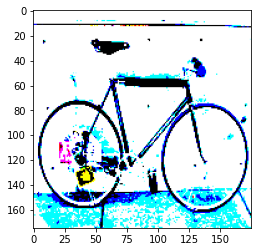

rank: 1506
predicted label: 1.0
true label: 1
Class name bicycle


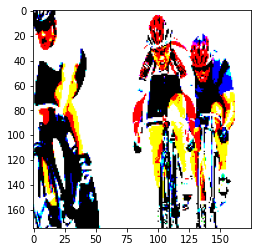

class name: bird
rank: 1861
predicted label: 1.0
true label: 1
Class name bird


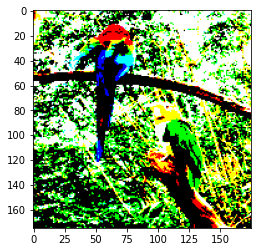

rank: 1013
predicted label: 1.0
true label: 1
Class name bird


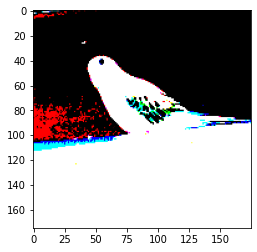

rank: 1015
predicted label: 1.0
true label: 1
Class name bird


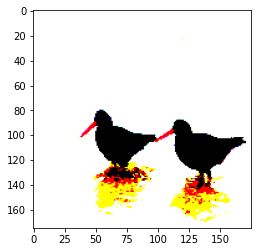

rank: 1838
predicted label: 1.0
true label: 1
Class name bird


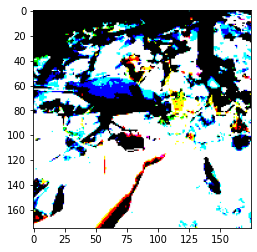

rank: 1831
predicted label: 1.0
true label: 1
Class name bird


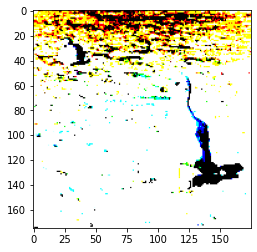

rank: 1101
predicted label: 1.0
true label: 1
Class name bird


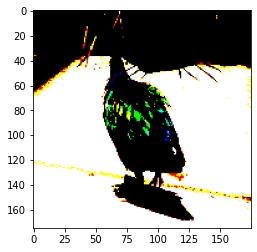

rank: 87
predicted label: 1.0
true label: 1
Class name bird


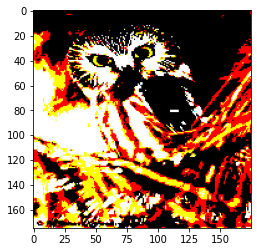

rank: 334
predicted label: 1.0
true label: 1
Class name bird


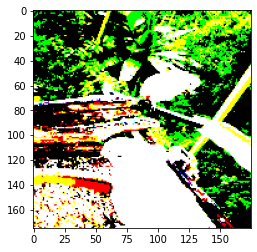

rank: 1008
predicted label: 1.0
true label: 1
Class name bird


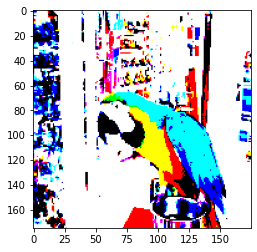

rank: 571
predicted label: 1.0
true label: 1
Class name bird


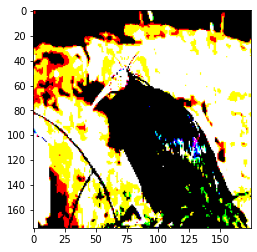

class name: boat
rank: 1835
predicted label: 0.9998499
true label: 0
Class name boat


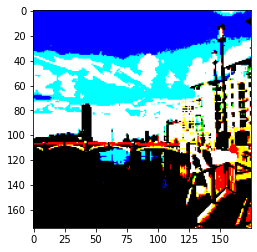

rank: 653
predicted label: 0.99995387
true label: 1
Class name boat


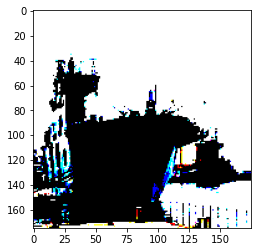

rank: 1580
predicted label: 0.9999682
true label: 1
Class name boat


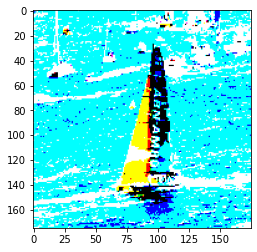

rank: 1112
predicted label: 0.9999819
true label: 1
Class name boat


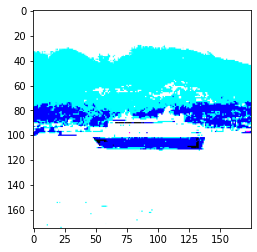

rank: 1853
predicted label: 0.9999969
true label: 1
Class name boat


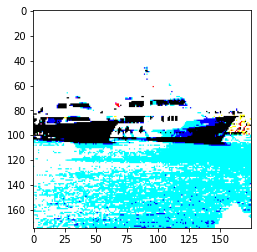

rank: 1002
predicted label: 0.9999994
true label: 1
Class name boat


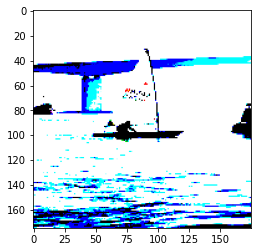

rank: 1184
predicted label: 0.99999964
true label: 1
Class name boat


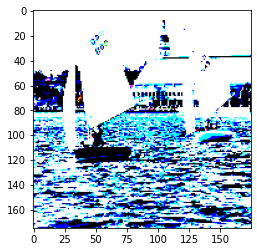

rank: 1947
predicted label: 0.9999999
true label: 1
Class name boat


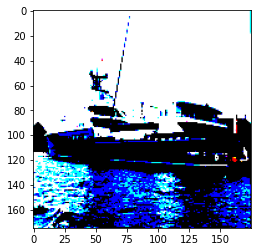

rank: 214
predicted label: 0.9999999
true label: 1
Class name boat


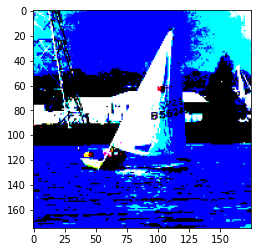

rank: 170
predicted label: 1.0
true label: 1
Class name boat


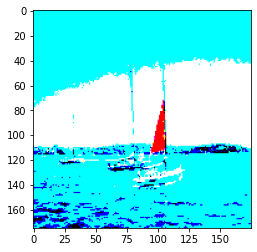

class name: bottle
rank: 1404
predicted label: 0.99991846
true label: 0
Class name bottle


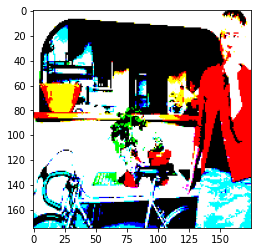

rank: 1326
predicted label: 0.9999243
true label: 1
Class name bottle


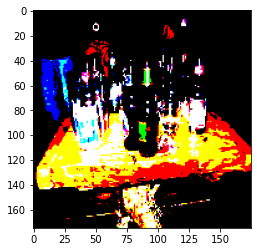

rank: 1217
predicted label: 0.9999379
true label: 0
Class name bottle


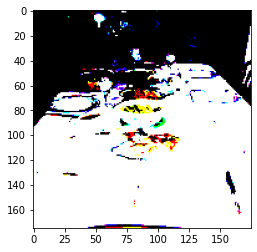

rank: 188
predicted label: 0.9999738
true label: 0
Class name bottle


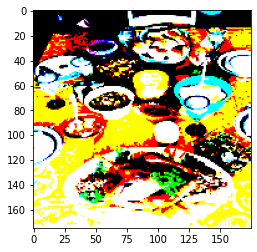

rank: 1893
predicted label: 0.9999827
true label: 1
Class name bottle


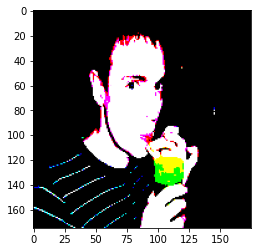

rank: 1345
predicted label: 0.9999864
true label: 0
Class name bottle


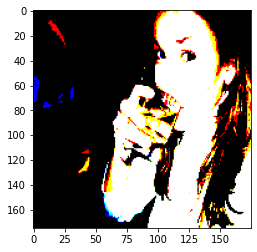

rank: 1381
predicted label: 0.9999974
true label: 1
Class name bottle


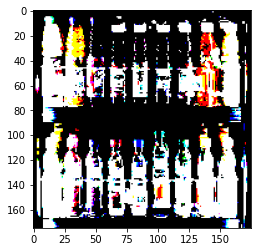

rank: 394
predicted label: 0.9999999
true label: 1
Class name bottle


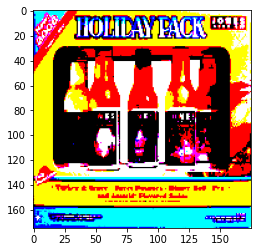

rank: 496
predicted label: 1.0
true label: 1
Class name bottle


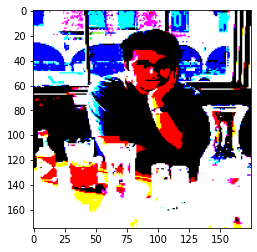

rank: 1267
predicted label: 1.0
true label: 1
Class name bottle


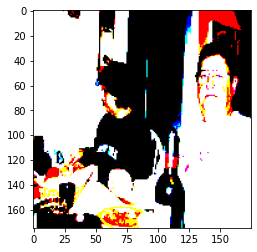

class name: bus
rank: 852
predicted label: 0.9999995
true label: 0
Class name bus


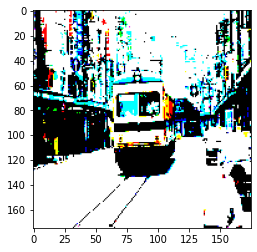

rank: 458
predicted label: 0.9999999
true label: 1
Class name bus


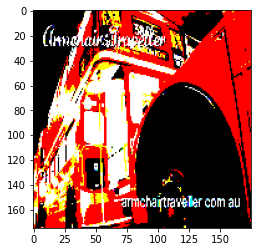

rank: 1581
predicted label: 1.0
true label: 1
Class name bus


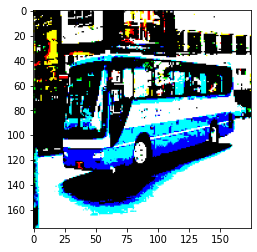

rank: 953
predicted label: 1.0
true label: 1
Class name bus


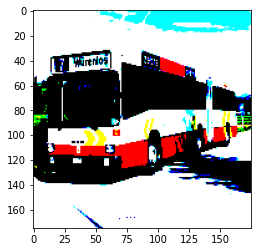

rank: 1832
predicted label: 1.0
true label: 1
Class name bus


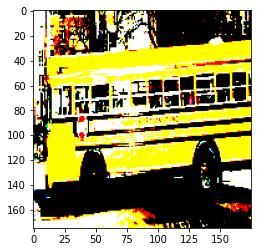

rank: 1688
predicted label: 1.0
true label: 1
Class name bus


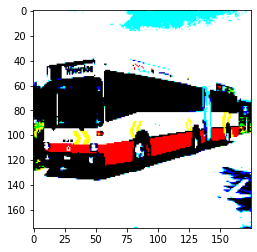

rank: 1786
predicted label: 1.0
true label: 1
Class name bus


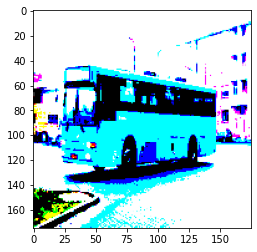

rank: 643
predicted label: 1.0
true label: 1
Class name bus


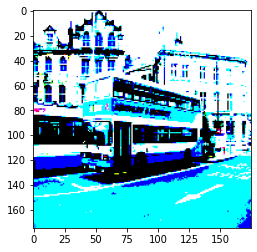

rank: 1761
predicted label: 1.0
true label: 1
Class name bus


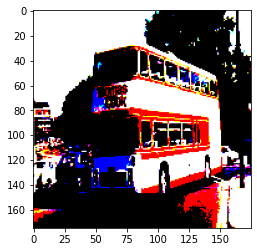

rank: 320
predicted label: 1.0
true label: 1
Class name bus


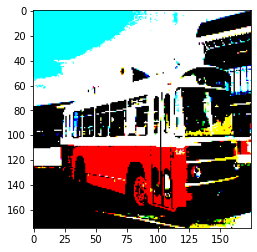

class name: car
rank: 249
predicted label: 1.0
true label: 1
Class name car


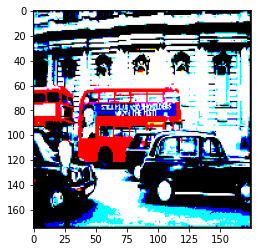

rank: 1791
predicted label: 1.0
true label: 1
Class name car


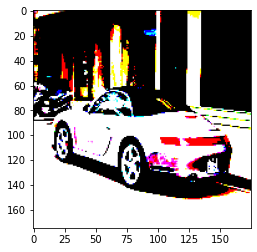

rank: 832
predicted label: 1.0
true label: 1
Class name car


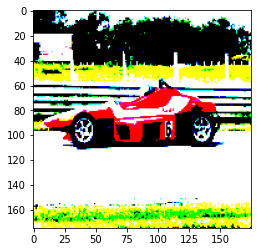

rank: 827
predicted label: 1.0
true label: 1
Class name car


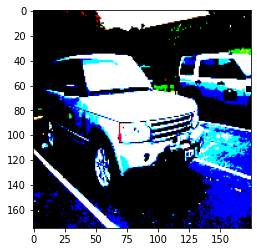

rank: 814
predicted label: 1.0
true label: 1
Class name car


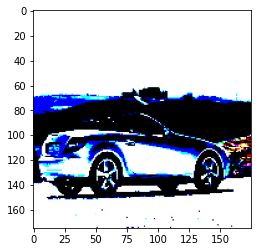

rank: 1762
predicted label: 1.0
true label: 1
Class name car


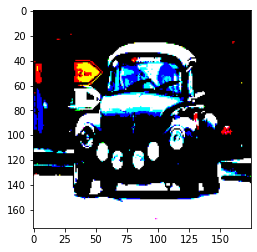

rank: 1759
predicted label: 1.0
true label: 1
Class name car


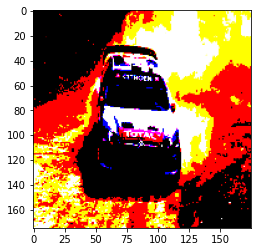

rank: 1753
predicted label: 1.0
true label: 1
Class name car


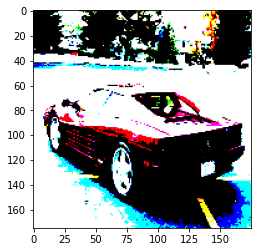

rank: 919
predicted label: 1.0
true label: 1
Class name car


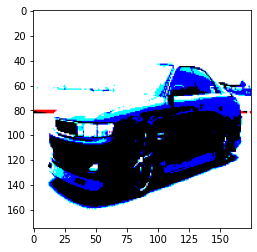

rank: 1123
predicted label: 1.0
true label: 1
Class name car


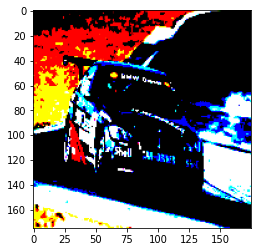

class name: cat
rank: 1187
predicted label: 1.0
true label: 1
Class name cat


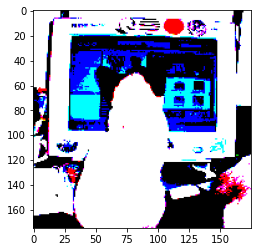

rank: 1283
predicted label: 1.0
true label: 1
Class name cat


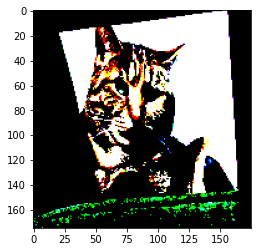

rank: 713
predicted label: 1.0
true label: 1
Class name cat


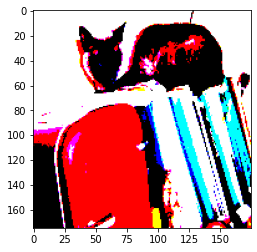

rank: 1147
predicted label: 1.0
true label: 1
Class name cat


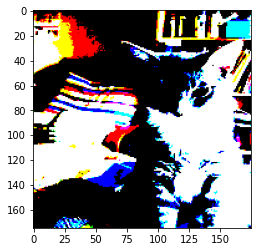

rank: 537
predicted label: 1.0
true label: 1
Class name cat


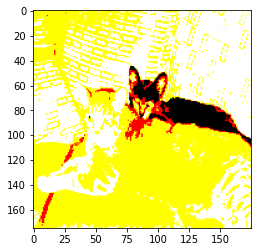

rank: 1796
predicted label: 1.0
true label: 1
Class name cat


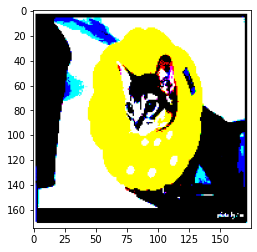

rank: 912
predicted label: 1.0
true label: 1
Class name cat


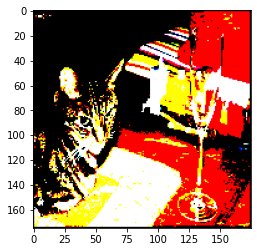

rank: 1660
predicted label: 1.0
true label: 1
Class name cat


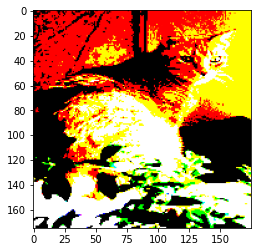

rank: 39
predicted label: 1.0
true label: 1
Class name cat


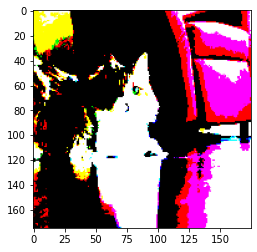

rank: 1426
predicted label: 1.0
true label: 1
Class name cat


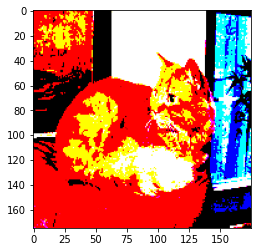

class name: chair
rank: 946
predicted label: 0.99986064
true label: 1
Class name chair


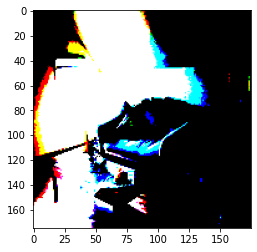

rank: 1667
predicted label: 0.99986255
true label: 1
Class name chair


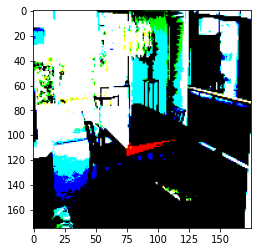

rank: 422
predicted label: 0.9999682
true label: 1
Class name chair


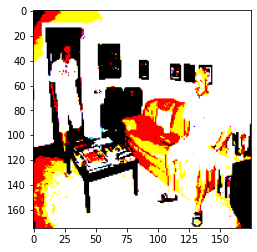

rank: 405
predicted label: 0.99998736
true label: 1
Class name chair


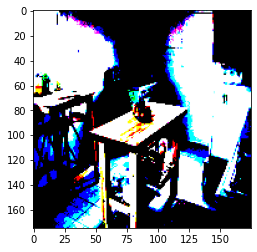

rank: 205
predicted label: 0.99999094
true label: 1
Class name chair


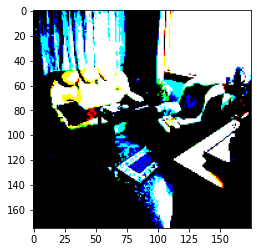

rank: 881
predicted label: 0.9999931
true label: 1
Class name chair


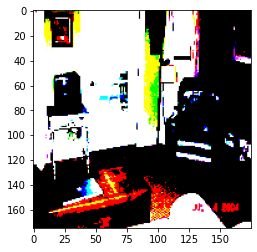

rank: 667
predicted label: 0.99999714
true label: 0
Class name chair


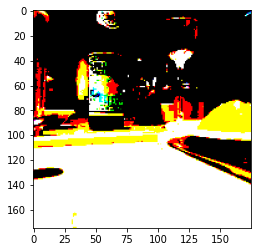

rank: 1400
predicted label: 0.99999774
true label: 1
Class name chair


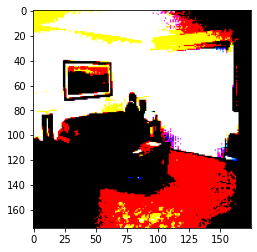

rank: 1942
predicted label: 0.99999774
true label: 1
Class name chair


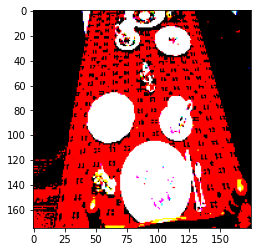

rank: 1788
predicted label: 0.9999999
true label: 1
Class name chair


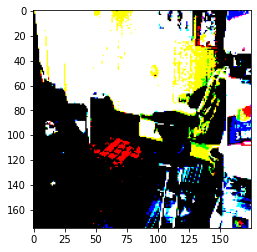

class name: cow
rank: 311
predicted label: 0.9999882
true label: 0
Class name cow


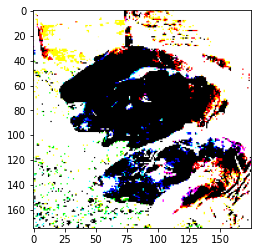

rank: 804
predicted label: 0.9999962
true label: 1
Class name cow


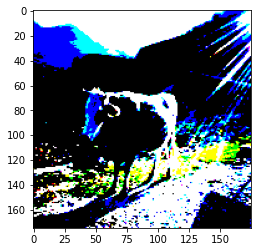

rank: 93
predicted label: 0.99999726
true label: 1
Class name cow


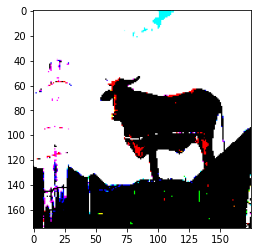

rank: 1587
predicted label: 0.9999987
true label: 1
Class name cow


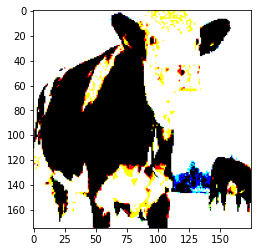

rank: 1922
predicted label: 0.99999964
true label: 0
Class name cow


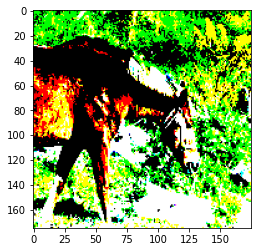

rank: 1469
predicted label: 0.99999976
true label: 0
Class name cow


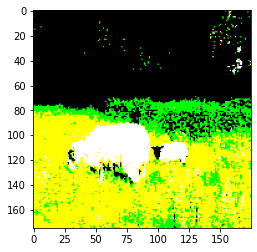

rank: 164
predicted label: 0.99999976
true label: 1
Class name cow


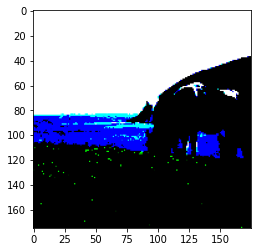

rank: 1255
predicted label: 1.0
true label: 1
Class name cow


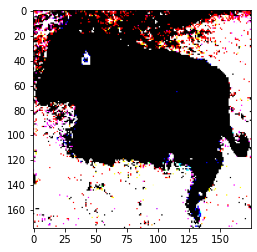

rank: 437
predicted label: 1.0
true label: 1
Class name cow


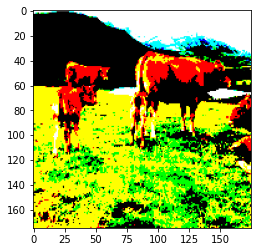

rank: 914
predicted label: 1.0
true label: 1
Class name cow


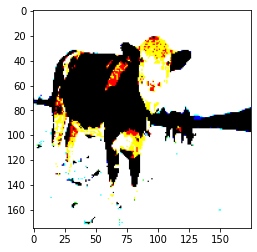

class name: diningtable
rank: 1551
predicted label: 0.99141407
true label: 0
Class name diningtable


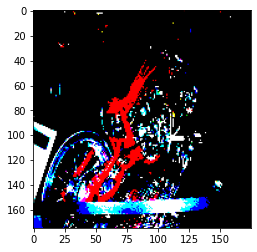

rank: 1009
predicted label: 0.994024
true label: 0
Class name diningtable


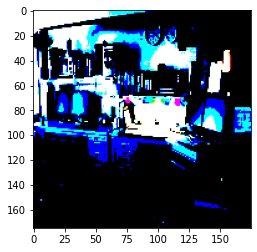

rank: 1902
predicted label: 0.995628
true label: 0
Class name diningtable


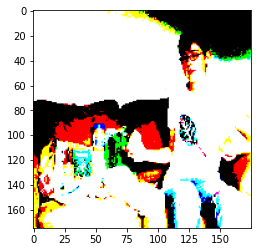

rank: 582
predicted label: 0.9988341
true label: 0
Class name diningtable


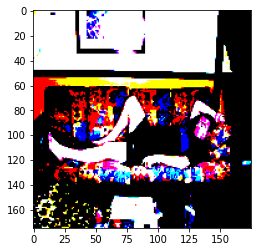

rank: 1967
predicted label: 0.9995315
true label: 1
Class name diningtable


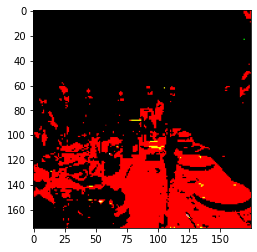

rank: 1165
predicted label: 0.9998516
true label: 0
Class name diningtable


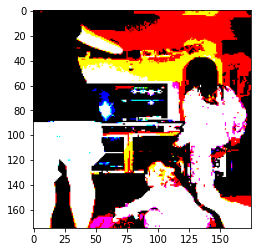

rank: 1623
predicted label: 0.99988437
true label: 1
Class name diningtable


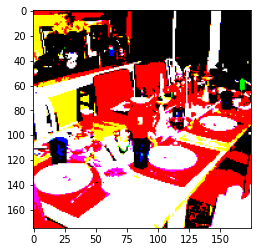

rank: 1239
predicted label: 0.9999771
true label: 0
Class name diningtable


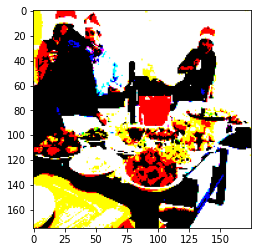

rank: 1755
predicted label: 0.9999994
true label: 1
Class name diningtable


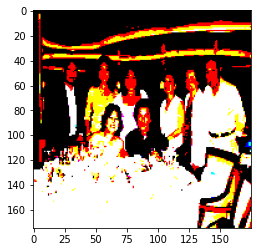

rank: 1217
predicted label: 1.0
true label: 1
Class name diningtable


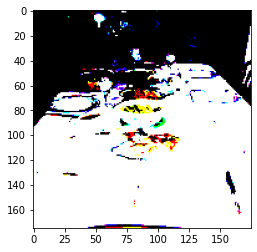

class name: dog
rank: 616
predicted label: 1.0
true label: 1
Class name dog


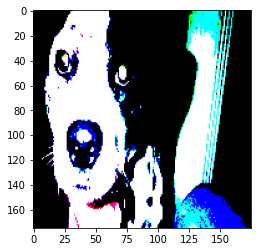

rank: 14
predicted label: 1.0
true label: 1
Class name dog


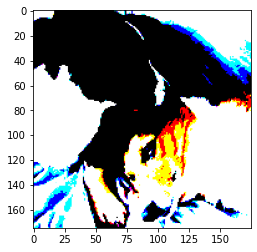

rank: 1974
predicted label: 1.0
true label: 1
Class name dog


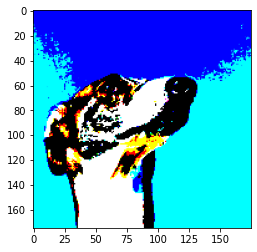

rank: 696
predicted label: 1.0
true label: 1
Class name dog


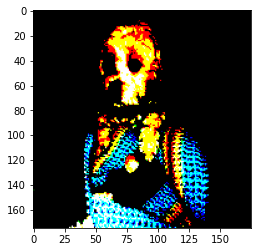

rank: 316
predicted label: 1.0
true label: 1
Class name dog


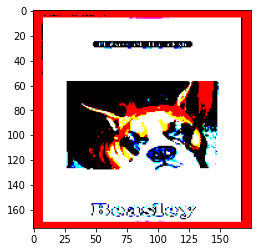

rank: 474
predicted label: 1.0
true label: 1
Class name dog


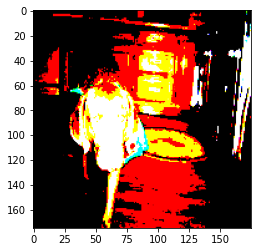

rank: 886
predicted label: 1.0
true label: 1
Class name dog


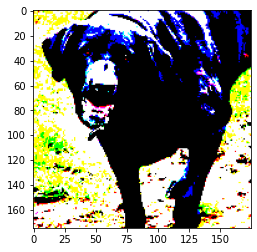

rank: 1253
predicted label: 1.0
true label: 1
Class name dog


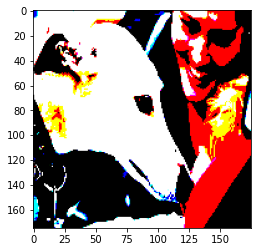

rank: 339
predicted label: 1.0
true label: 1
Class name dog


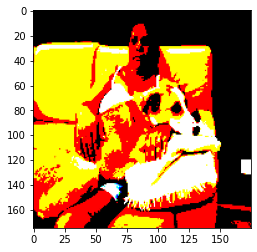

rank: 1301
predicted label: 1.0
true label: 1
Class name dog


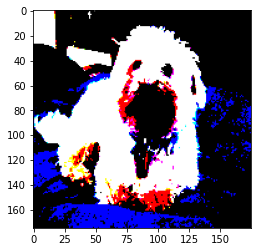

class name: horse
rank: 606
predicted label: 0.99999976
true label: 1
Class name horse


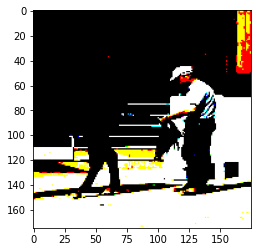

rank: 792
predicted label: 0.99999976
true label: 1
Class name horse


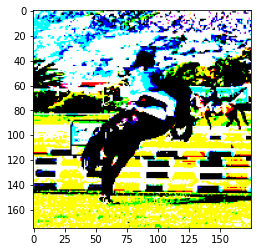

rank: 555
predicted label: 0.9999999
true label: 1
Class name horse


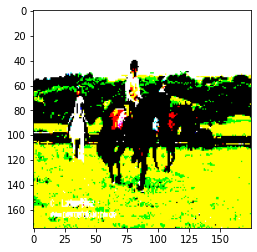

rank: 578
predicted label: 0.9999999
true label: 1
Class name horse


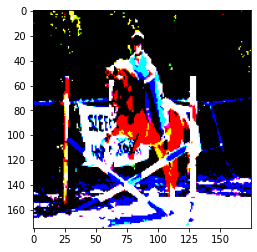

rank: 1696
predicted label: 0.9999999
true label: 1
Class name horse


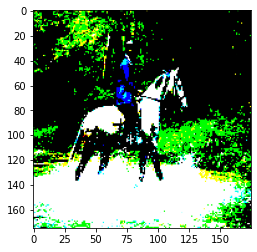

rank: 1973
predicted label: 0.9999999
true label: 1
Class name horse


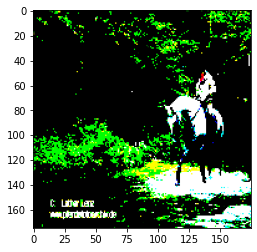

rank: 1775
predicted label: 0.9999999
true label: 1
Class name horse


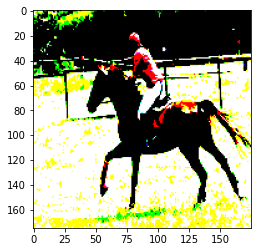

rank: 38
predicted label: 1.0
true label: 1
Class name horse


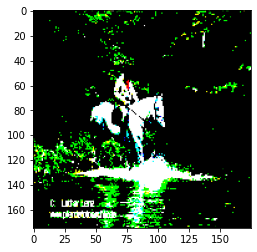

rank: 1406
predicted label: 1.0
true label: 1
Class name horse


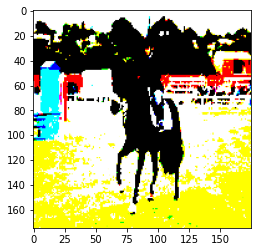

rank: 1299
predicted label: 1.0
true label: 1
Class name horse


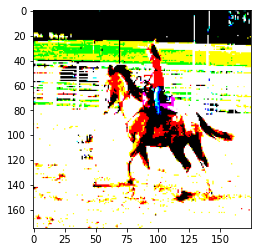

class name: motorbike
rank: 1703
predicted label: 1.0
true label: 1
Class name motorbike


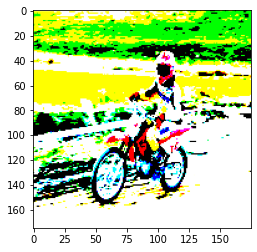

rank: 1946
predicted label: 1.0
true label: 1
Class name motorbike


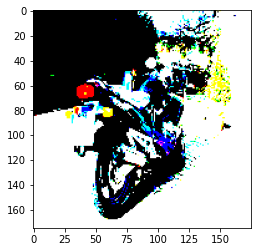

rank: 1925
predicted label: 1.0
true label: 1
Class name motorbike


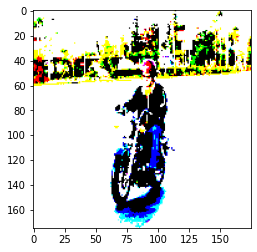

rank: 831
predicted label: 1.0
true label: 1
Class name motorbike


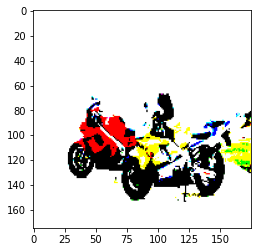

rank: 962
predicted label: 1.0
true label: 0
Class name motorbike


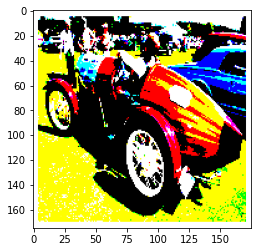

rank: 1502
predicted label: 1.0
true label: 1
Class name motorbike


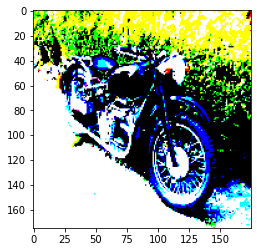

rank: 202
predicted label: 1.0
true label: 1
Class name motorbike


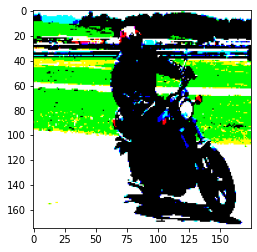

rank: 860
predicted label: 1.0
true label: 1
Class name motorbike


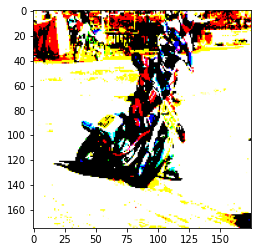

rank: 1437
predicted label: 1.0
true label: 1
Class name motorbike


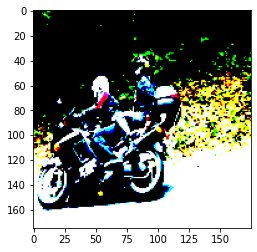

rank: 1814
predicted label: 1.0
true label: 1
Class name motorbike


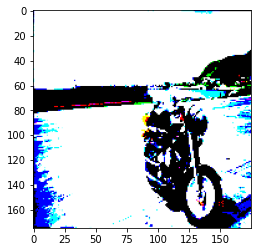

class name: person
rank: 1906
predicted label: 1.0
true label: 1
Class name person


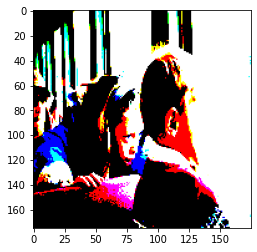

rank: 1062
predicted label: 1.0
true label: 1
Class name person


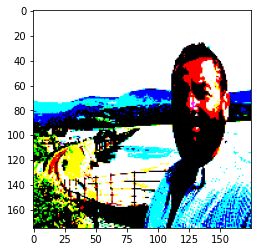

rank: 202
predicted label: 1.0
true label: 1
Class name person


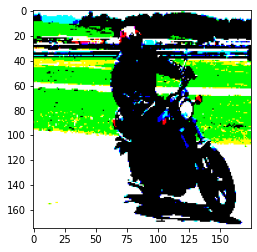

rank: 1902
predicted label: 1.0
true label: 1
Class name person


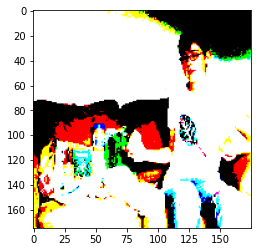

rank: 212
predicted label: 1.0
true label: 1
Class name person


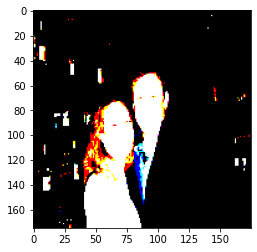

rank: 216
predicted label: 1.0
true label: 1
Class name person


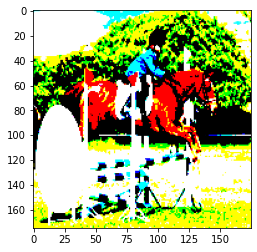

rank: 1064
predicted label: 1.0
true label: 1
Class name person


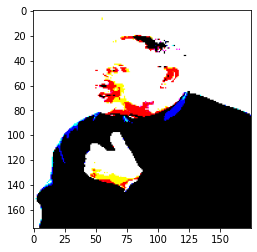

rank: 498
predicted label: 1.0
true label: 1
Class name person


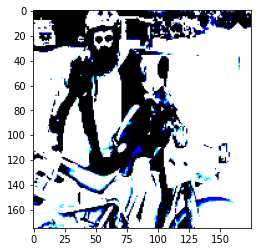

rank: 496
predicted label: 1.0
true label: 1
Class name person


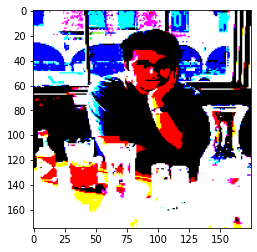

rank: 1362
predicted label: 1.0
true label: 1
Class name person


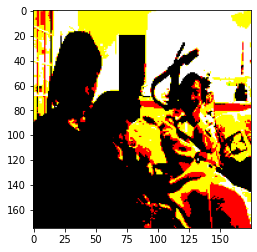

class name: pottedplant
rank: 1017
predicted label: 0.9996364
true label: 0
Class name pottedplant


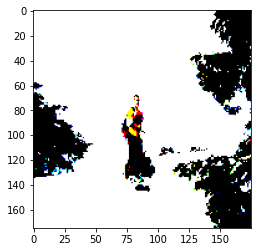

rank: 5
predicted label: 0.999754
true label: 1
Class name pottedplant


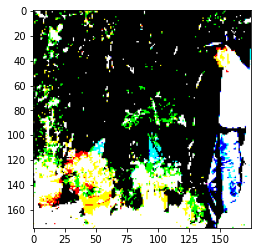

rank: 609
predicted label: 0.9997899
true label: 0
Class name pottedplant


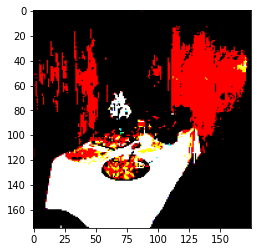

rank: 1674
predicted label: 0.9999374
true label: 1
Class name pottedplant


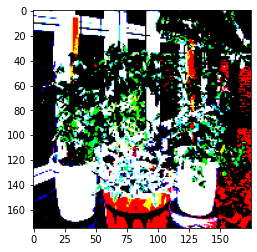

rank: 1266
predicted label: 0.9999523
true label: 0
Class name pottedplant


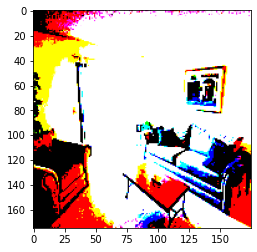

rank: 1262
predicted label: 0.9999857
true label: 1
Class name pottedplant


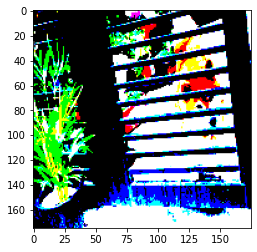

rank: 1234
predicted label: 0.9999956
true label: 1
Class name pottedplant


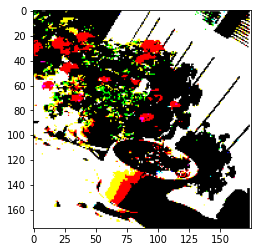

rank: 1944
predicted label: 0.9999964
true label: 1
Class name pottedplant


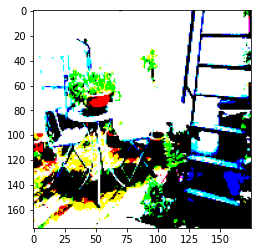

rank: 1538
predicted label: 0.9999999
true label: 1
Class name pottedplant


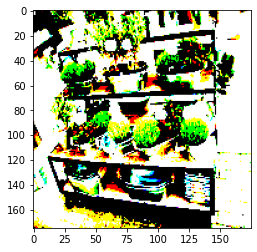

rank: 927
predicted label: 1.0
true label: 1
Class name pottedplant


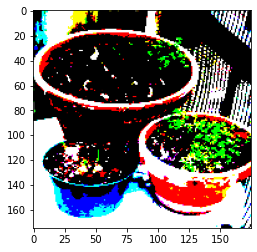

class name: sheep
rank: 1358
predicted label: 0.99988115
true label: 1
Class name sheep


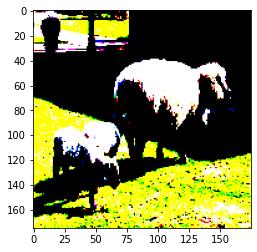

rank: 1469
predicted label: 0.9999665
true label: 1
Class name sheep


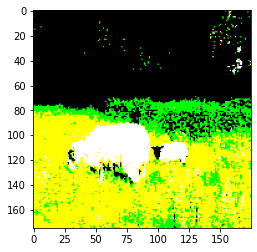

rank: 907
predicted label: 0.9999726
true label: 1
Class name sheep


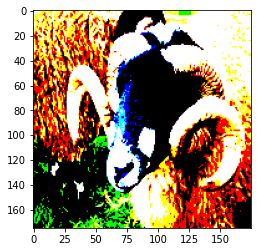

rank: 1530
predicted label: 0.9999753
true label: 0
Class name sheep


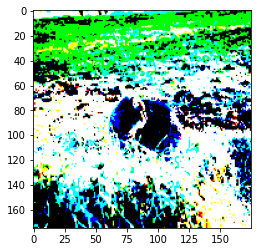

rank: 568
predicted label: 0.9999913
true label: 1
Class name sheep


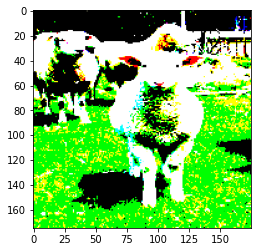

rank: 1327
predicted label: 0.9999933
true label: 1
Class name sheep


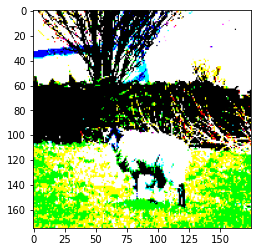

rank: 1632
predicted label: 0.99999857
true label: 1
Class name sheep


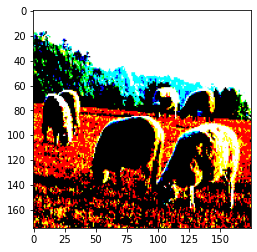

rank: 970
predicted label: 0.99999964
true label: 0
Class name sheep


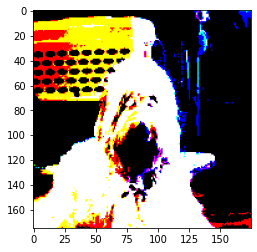

rank: 494
predicted label: 1.0
true label: 1
Class name sheep


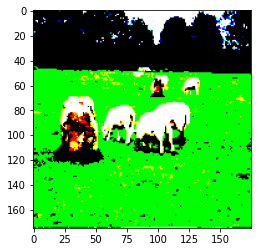

rank: 868
predicted label: 1.0
true label: 1
Class name sheep


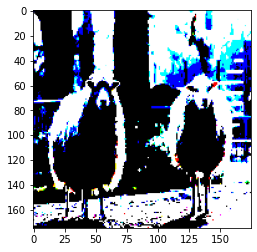

class name: sofa
rank: 1369


predicted label: 0.9987909
true label: 1
Class name sofa


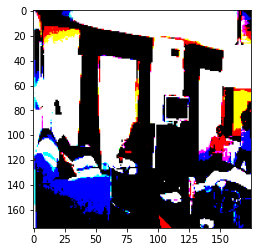

rank: 1407
predicted label: 0.9988053
true label: 0
Class name sofa


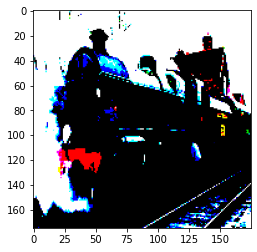

rank: 284
predicted label: 0.9992902
true label: 0
Class name sofa


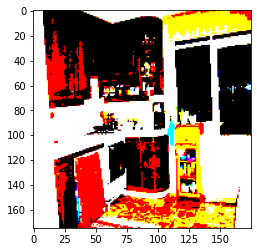

rank: 1266
predicted label: 0.9995685
true label: 1
Class name sofa


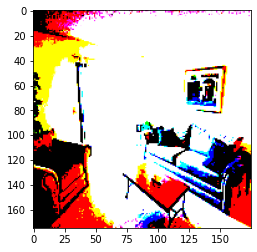

rank: 603
predicted label: 0.99979395
true label: 1
Class name sofa


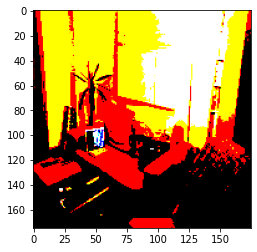

rank: 1027
predicted label: 0.9998733
true label: 1
Class name sofa


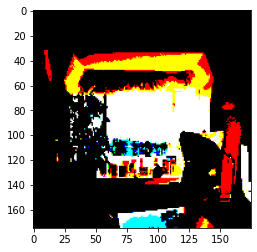

rank: 1691
predicted label: 0.9999951
true label: 0
Class name sofa


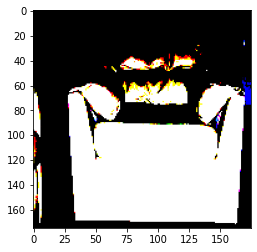

rank: 917
predicted label: 0.9999957
true label: 1
Class name sofa


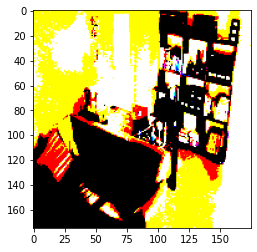

rank: 116
predicted label: 0.9999969
true label: 0
Class name sofa


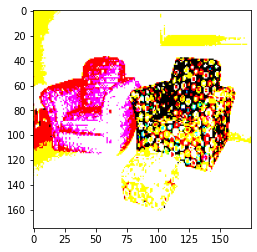

rank: 419
predicted label: 0.99999964
true label: 1
Class name sofa


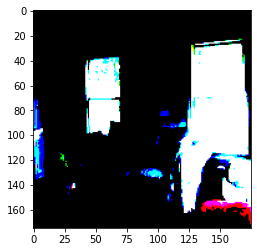

class name: train
rank: 42
predicted label: 1.0
true label: 1
Class name train


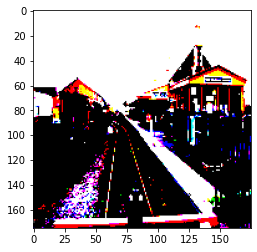

rank: 86
predicted label: 1.0
true label: 1
Class name train


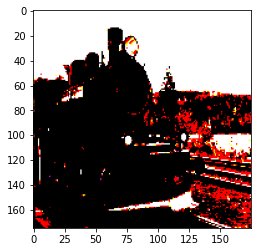

rank: 1011
predicted label: 1.0
true label: 1
Class name train


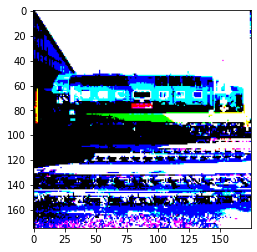

rank: 1076
predicted label: 1.0
true label: 1
Class name train


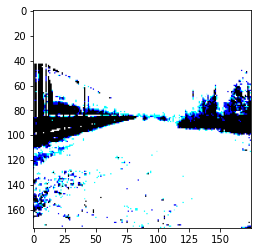

rank: 372
predicted label: 1.0
true label: 1
Class name train


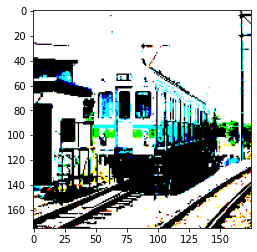

rank: 1145
predicted label: 1.0
true label: 1
Class name

 train


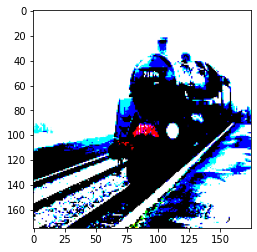

rank: 1724
predicted label: 1.0
true label: 1
Class name train


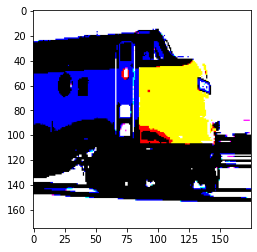

rank: 1304
predicted label: 1.0
true label: 1
Class name train


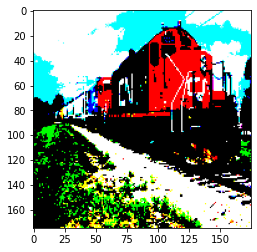

rank: 613
predicted label: 1.0
true label: 1
Class name train


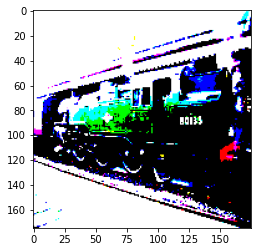

rank: 1511
predicted label: 1.0
true label: 1
Class name train


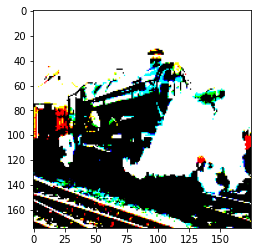

class name: tvmonitor
rank: 1499
predicted label: 0.9999995
true label: 0
Class name tvmonitor


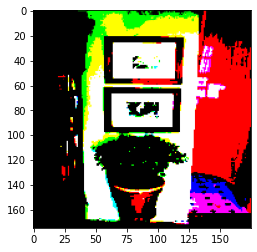

rank: 1497
predicted label: 0.9999995
true label: 1
Class name tvmonitor


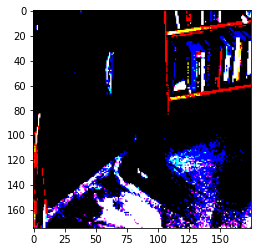

rank: 1573
predicted label: 0.99999964
true label: 1
Class name tvmonitor


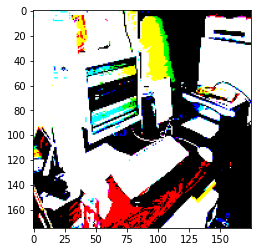

rank: 2
predicted label: 0.99999976
true label: 1
Class name tvmonitor


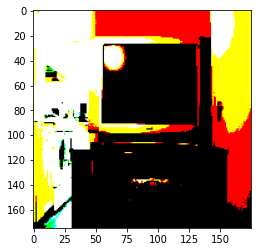

rank: 1433
predicted label: 0.9999999
true label: 1
Class name tvmonitor


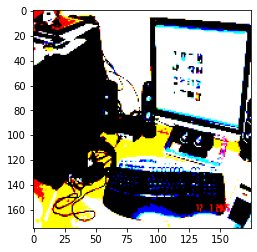

rank: 1598
predicted label: 0.9999999
true label: 1
Class name tvmonitor


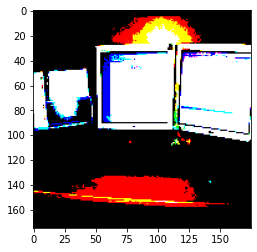

rank: 604
predicted label: 1.0
true label: 1
Class name tvmonitor


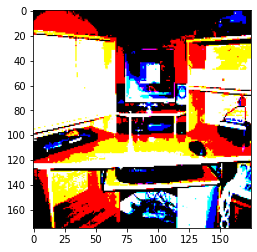

rank: 1004
predicted label: 1.0
true label: 1
Class name tvmonitor


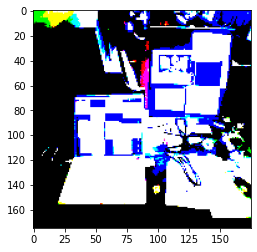

rank: 1066
predicted label: 1.0
true label: 1
Class name tvmonitor


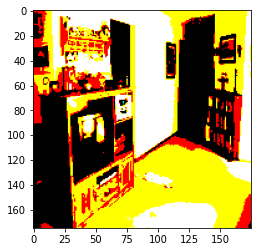

rank: 1708
predicted label: 1.0
true label: 1
Class name tvmonitor


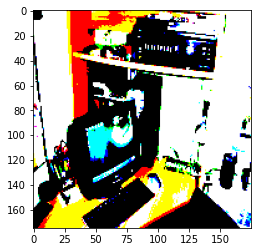

In [ ]:
# show the top 10 ranked photos for each class

def show_top10_ranked_photos(X_test, y_test, y_pred, class_names):
    y_pred = np.asarray(y_pred)
    y_test = np.asarray(y_test)
    X_test = np.asarray(X_test)
    print("X_test shape:", X_test.shape)
    print("y_test shape:", y_test.shape)
    print("y_pred shape:", y_pred.shape)
    print("class_names shape:", len(class_names))
    for i in range(20):
        print("class name:", class_names[i])
        # get the top 10 ranked photos
        top10 = np.argsort(y_pred[:, i])[-10:]
        for j in top10:
            print("rank:", j)
            print("predicted label:", y_pred[j, i])
            print("true label:", y_test[j, i])
            print("Class name", class_names[i])
            plt.imshow(X_test[j])
            plt.show()

show_top10_ranked_photos(X_test, y_test, y_pred, class_names)

## Pre-Trained Model `ResNet_50`

In [ ]:
from tensorflow.keras.applications.resnet50 import ResNet50
mdl = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape, pooling='max')
for layer in mdl.layers:
    layer.trainable = False  

94765736/94765736 [==============================] - 5s 0us/step


In [ ]:
x = mdl.output
x = Dense(1024, activation='relu')(x)
predictions = Dense(20, activation='sigmoid')(x)


In [ ]:
my_Model = Model(inputs=mdl.input, outputs=predictions, name='My_Model')
my_Model.summary()

Model: "My_Model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 175, 175, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 181, 181, 3)  0           ['input_3[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 88, 88, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 88, 88, 64)   256         ['conv1_conv[0][0]']      

In [ ]:
opt = tf.keras.optimizers.Adam(lr=0.001, decay=1e-6)
my_Model.compile(loss='binary_crossentropy',
                        optimizer=opt, metrics=['accuracy'])

batch_size = 512
epochs = 20
history = my_Model.fit_generator(datagen.flow(X_train, y_train, batch_size=batch_size),
                    epochs=epochs, validation_data=(X_val, y_val),shuffle=True)

<ipython-input-47-146cb016ce5c>:7: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = my_Model.fit_generator(datagen.flow(X_train, y_train, batch_size=batch_size),


Epoch 1/20
5/5 [==============================] - 34s 5s/step - loss: 2.7917 - accuracy: 0.0852 - val_loss: 2.3501 - val_accuracy: 0.1299
Epoch 2/20
5/5 [==============================] - 26s 6s/step - loss: 1.9865 - accuracy: 0.2155 - val_loss: 1.5004 - val_accuracy: 0.2327
Epoch 3/20
5/5 [==============================] - 21s 4s/step - loss: 1.1786 - accuracy: 0.2931 - val_loss: 0.9271 - val_accuracy: 0.3279
Epoch 4/20
5/5 [==============================] - 21s 4s/step - loss: 0.6517 - accuracy: 0.3695 - val_loss: 0.5150 - val_accuracy: 0.3665
Epoch 5/20
5/5 [==============================] - 23s 5s/step - loss: 0.4556 - accuracy: 0.4294 - val_loss: 0.3498 - val_accuracy: 0.4538
Epoch 6/20
5/5 [==============================] - 21s 4s/step - loss: 0.2921 - accuracy: 0.4322 - val_loss: 0.2687 - val_accuracy: 0.4522
Epoch 7/20
5/5 [==============================] - 21s 4s/step - loss: 0.2384 - accuracy: 0.5034 - val_loss: 0.2412 - val_accuracy: 0.5036
Epoch 8/20
5/5 [==================

In [ ]:
# calculte mean average precision from the model.history
def map_from_history(history):
    map = 0
    for i in range(len(history.history['val_accuracy'])):
        map += history.history['val_accuracy'][i]
    map /= len(history.history['val_accuracy'])
    return map

print("mean average precision:", map_from_history(history))

mean average precision: 0.48699203208088876


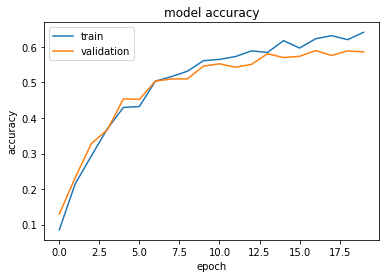

In [ ]:
# plot the training and validation accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')

plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

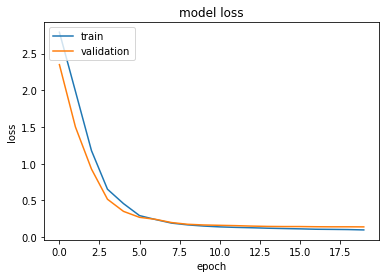

In [ ]:
# plot the training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
# evaluate the model
score = my_Model.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy: %.2f%%' % (score[1]*100))

Test loss: 0.13114118576049805
Test accuracy: 60.05%


In [ ]:
# predict the test data
y_pred = my_Model.predict(X_test)

63/63 [==============================] - 5s 66ms/step


X_test shape: (2000, 175, 175, 3)
y_test shape: (2000, 20)
y_pred shape: (2000, 20)
class_names shape: 20
class name: aeroplane
rank: 1330
predicted label: 0.9999794
true label: 1
Class name aeroplane


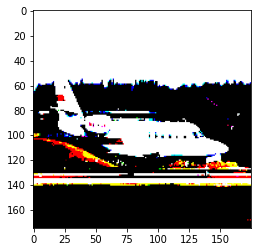

rank: 403
predicted label: 0.99998665
true label: 1
Class name aeroplane


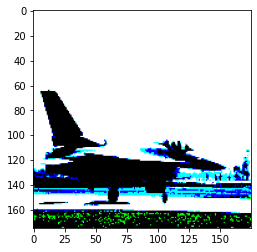

rank: 1048
predicted label: 0.99998736
true label: 1
Class name aeroplane


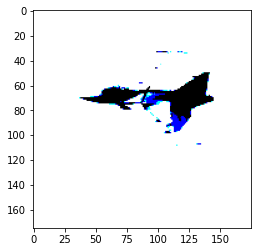

rank: 1851
predicted label: 0.9999908
true label: 1
Class name aeroplane


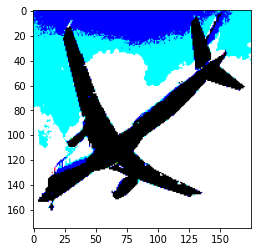

rank: 822
predicted label: 0.99999213
true label: 1
Class name aeroplane


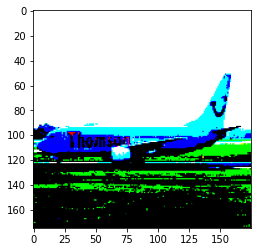

rank: 979
predicted label: 0.9999951
true label: 1
Class name aeroplane


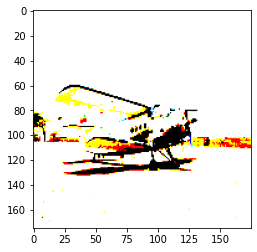

rank: 1754
predicted label: 0.99999917
true label: 1
Class name aeroplane


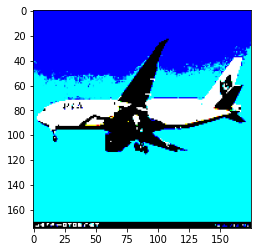

rank: 1719
predicted label: 0.99999964
true label: 1
Class name aeroplane


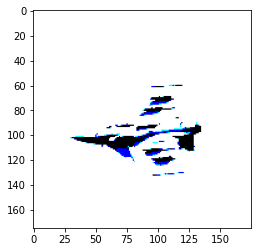

rank: 70
predicted label: 0.99999976
true label: 1
Class name aeroplane


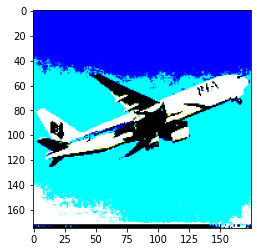

rank: 1813
predicted label: 1.0
true label: 1
Class name aeroplane


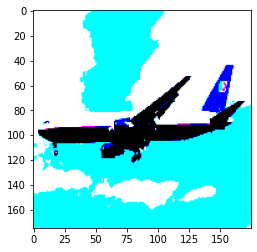

class name: bicycle
rank: 532
predicted label: 0.9990368
true label: 1
Class name bicycle


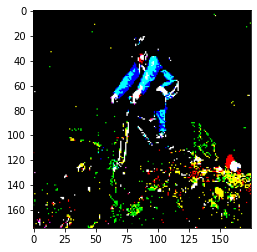

rank: 1571
predicted label: 0.99918395
true label: 1
Class name bicycle


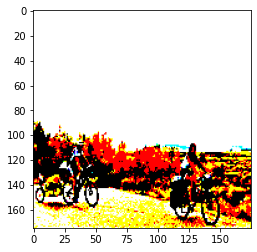

rank: 1028
predicted label: 0.99921584
true label: 1
Class name bicycle


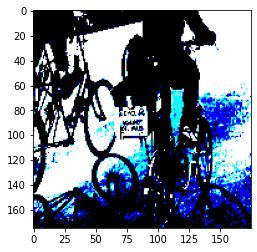

rank: 277
predicted label: 0.9994968
true label: 1
Class name bicycle


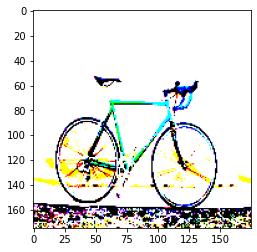

rank: 356
predicted label: 0.9995146
true label: 1
Class name bicycle


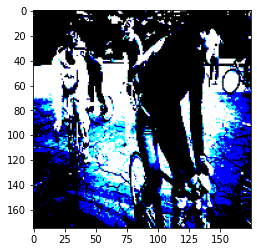

rank: 1619
predicted label: 0.99970263
true label: 1
Class name bicycle


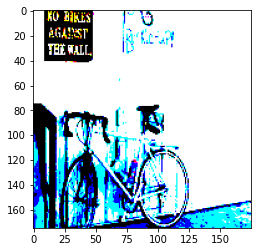

rank: 1888
predicted label: 0.999708
true label: 1
Class name bicycle


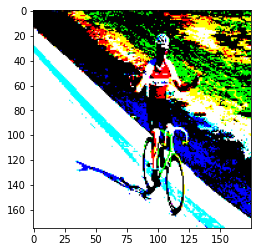

rank: 1988
predicted label: 0.9998299
true label: 1
Class name bicycle


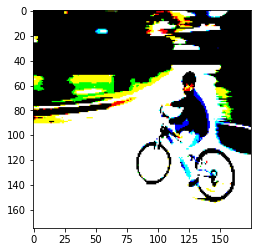

rank: 1339
predicted label: 0.999943
true label: 1
Class name bicycle


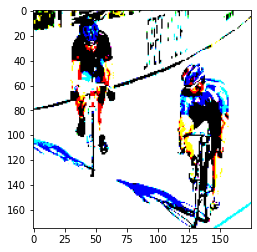

rank: 1397
predicted label: 0.99996185
true label: 1
Class name bicycle


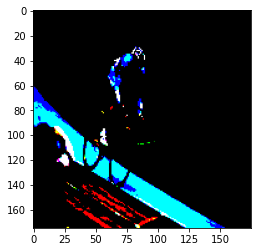

class name: bird
rank: 1265
predicted label: 0.9998791
true label: 1
Class name bird


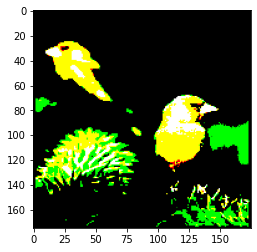

rank: 1912
predicted label: 0.99989104
true label: 1
Class name bird


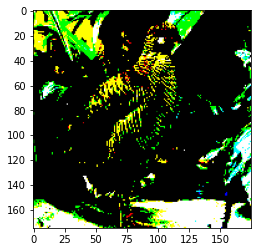

rank: 1861
predicted label: 0.9999002
true label: 1
Class name bird


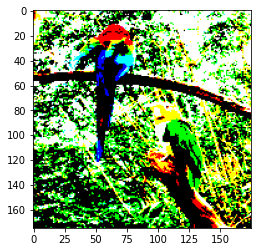

rank: 1160
predicted label: 0.99996316
true label: 1
Class name bird


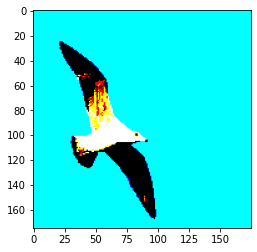

rank: 1464
predicted label: 0.9999747
true label: 1
Class name bird


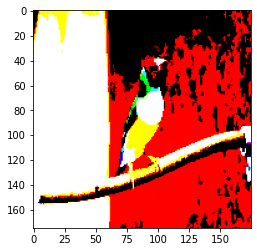

rank: 206
predicted label: 0.9999925
true label: 1
Class name bird


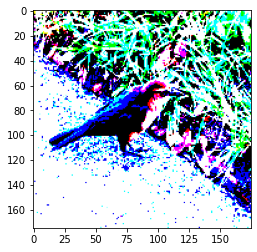

rank: 1950
predicted label: 0.9999926
true label: 1
Class name bird


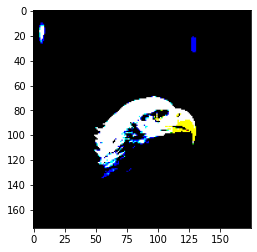

rank: 1415
predicted label: 0.9999926
true label: 1
Class name bird


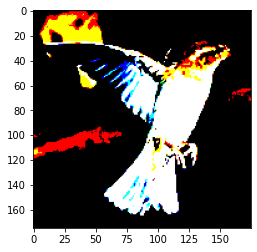

rank: 1457
predicted label: 0.99999344
true label: 1
Class name bird


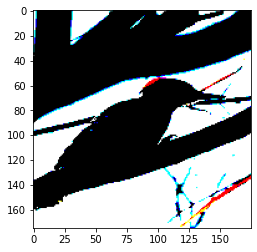

rank: 1236
predicted label: 0.9999989
true label: 1
Class name bird


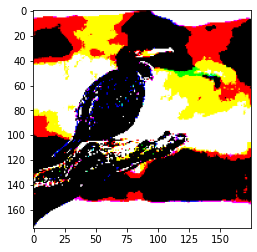

class name: boat
rank: 1580
predicted label: 0.9832876
true label: 1
Class name boat


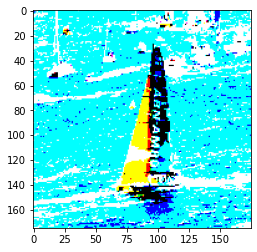

rank: 1853
predicted label: 0.9843613
true label: 1
Class name boat


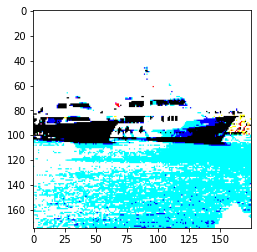

rank: 287
predicted label: 0.9851533
true label: 1
Class name boat


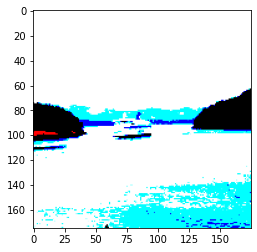

rank: 678
predicted label: 0.9867678
true label: 1
Class name boat


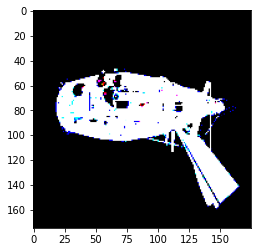

rank: 661
predicted label: 0.986896
true label: 1
Class name boat


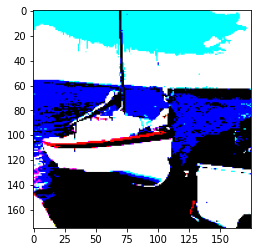

rank: 214
predicted label: 0.99038553
true label: 1
Class name boat


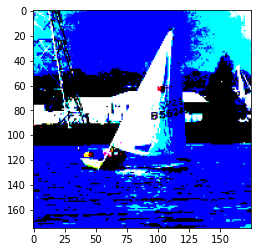

rank: 1184
predicted label: 0.9915665
true label: 1
Class name boat


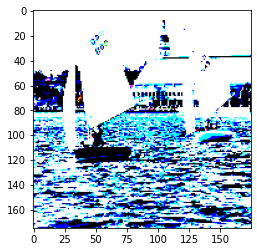

rank: 1947
predicted label: 0.99466103
true label: 1
Class name boat


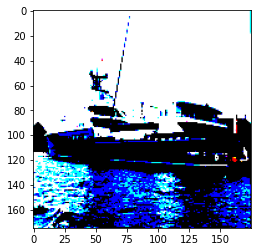

rank: 1665
predicted label: 0.9975267
true label: 1
Class name boat


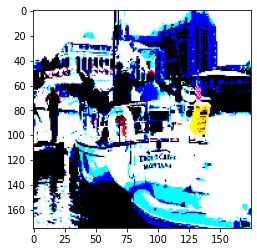

rank: 1484
predicted label: 0.9985026
true label: 1
Class name boat


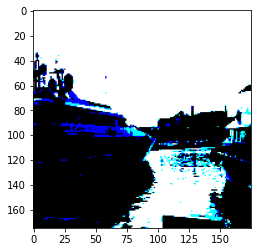

class name: bottle
rank: 73
predicted label: 0.9833282
true label: 0
Class name bottle


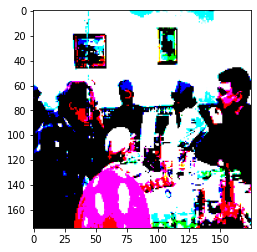

rank: 1447
predicted label: 0.9877764
true label: 0
Class name bottle


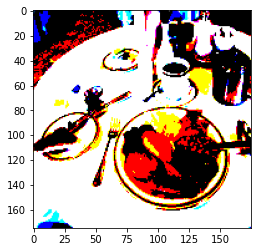

rank: 1785
predicted label: 0.9888604
true label: 0
Class name bottle


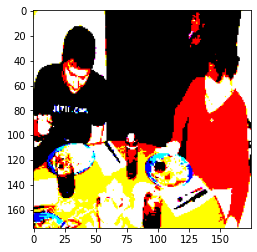

rank: 901
predicted label: 0.9896561
true label: 0
Class name bottle


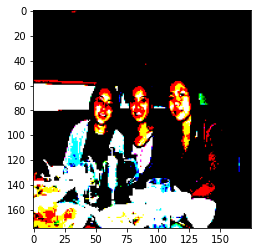

rank: 53
predicted label: 0.99083555
true label: 1
Class name bottle


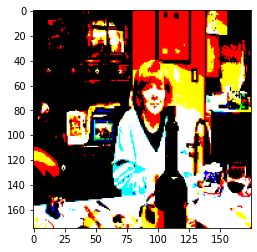

rank: 40
predicted label: 0.99184215
true label: 1
Class name bottle


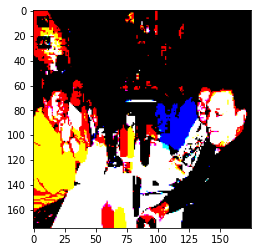

rank: 1787
predicted label: 0.9942986
true label: 1
Class name bottle


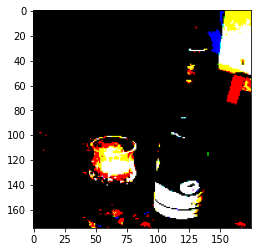

rank: 1392
predicted label: 0.994678
true label: 1
Class name bottle


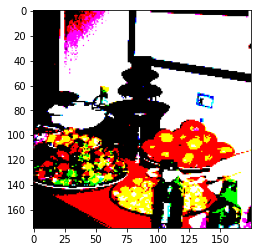

rank: 1267
predicted label: 0.99720675
true label: 1
Class name bottle


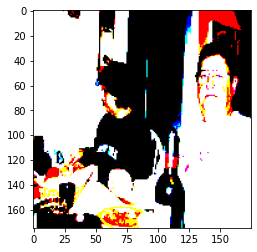

rank: 1671
predicted label: 0.99935466
true label: 1
Class name bottle


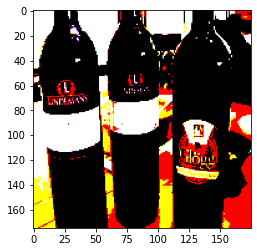

class name: bus
rank: 227
predicted label: 0.99719536
true label: 1
Class name bus


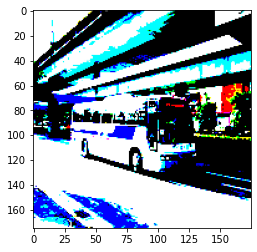

rank: 1563
predicted label: 0.9975212
true label: 1
Class name bus


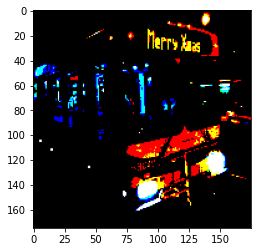

rank: 1455
predicted label: 0.9975407
true label: 1
Class name bus


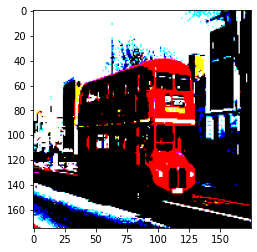

rank: 1936
predicted label: 0.9976031
true label: 1
Class name bus


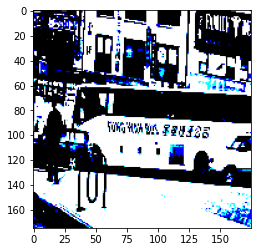

rank: 953
predicted label: 0.9976846
true label: 1
Class name bus


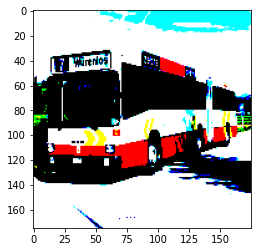

rank: 1581
predicted label: 0.9978138
true label: 1
Class name bus


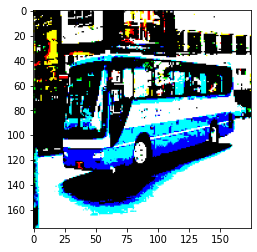

rank: 1764
predicted label: 0.9982843
true label: 1
Class name bus


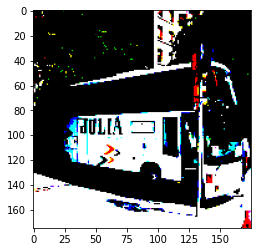

rank: 1688
predicted label: 0.9990497
true label: 1
Class name bus


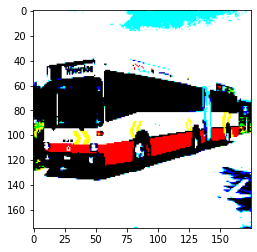

rank: 940
predicted label: 0.9992017
true label: 1
Class name bus


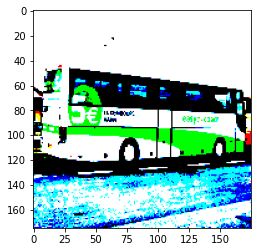

rank: 643
predicted label: 0.99979585
true label: 1
Class name bus


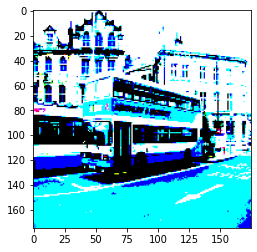

class name: car
rank: 1490
predicted label: 0.9999957
true label: 1
Class name car


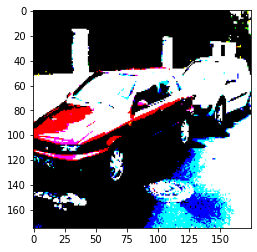

rank: 282
predicted label: 0.99999595
true label: 1
Class name car


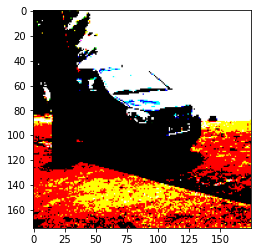

rank: 1489
predicted label: 0.9999964
true label: 1
Class name car


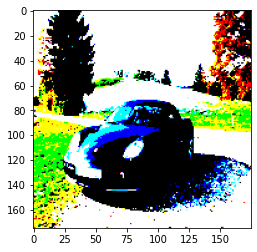

rank: 1880
predicted label: 0.99999714
true label: 1
Class name car


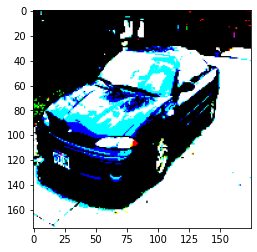

rank: 1791
predicted label: 0.99999726
true label: 1
Class name car


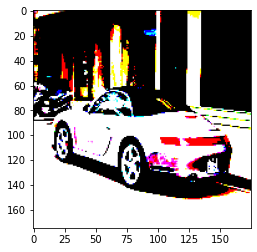

rank: 949
predicted label: 0.9999976
true label: 1
Class name car


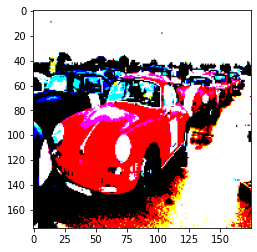

rank: 235
predicted label: 0.999998
true label: 1
Class name car


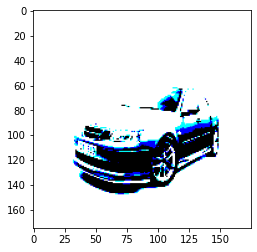

rank: 169
predicted label: 0.99999964
true label: 1
Class name car


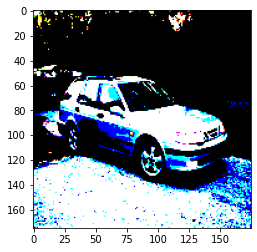

rank: 242
predicted label: 0.99999964
true label: 1
Class name car


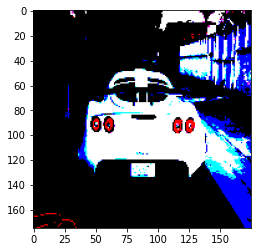

rank: 832
predicted label: 0.99999976
true label: 1
Class name car


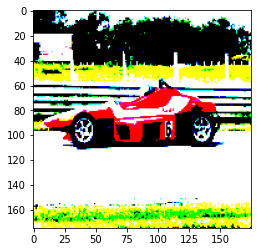

class name: cat
rank: 600
predicted label: 0.99995303
true label: 1
Class name cat


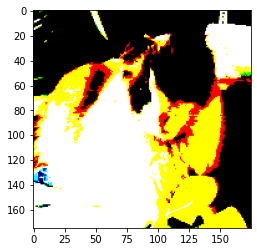

rank: 1109
predicted label: 0.9999546
true label: 1
Class name cat


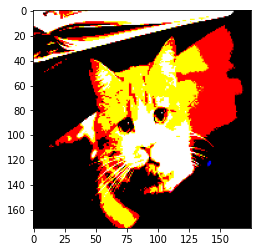

rank: 1657
predicted label: 0.9999616
true label: 1
Class name cat


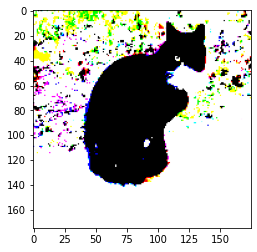

rank: 1291
predicted label: 0.999966
true label: 1
Class name cat


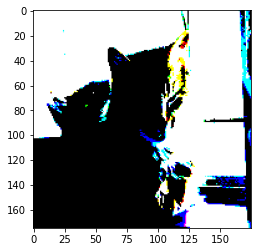

rank: 1147
predicted label: 0.9999734
true label: 1
Class name cat


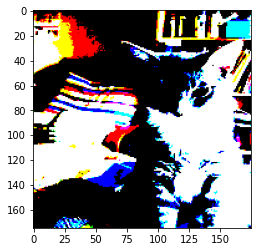

rank: 1874
predicted label: 0.99998343
true label: 1
Class name cat


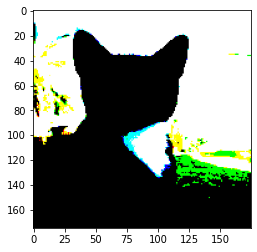

rank: 1705
predicted label: 0.9999846
true label: 1
Class name cat


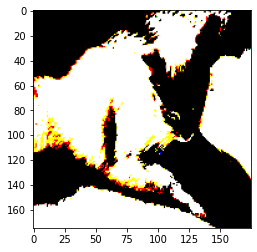

rank: 1940
predicted label: 0.9999882
true label: 1
Class name cat


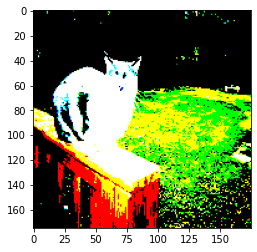

rank: 537
predicted label: 0.9999893
true label: 1
Class name cat


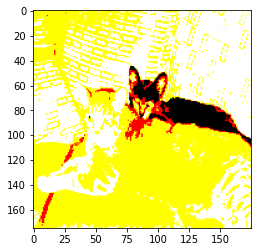

rank: 1034
predicted label: 0.9999937
true label: 1
Class name cat


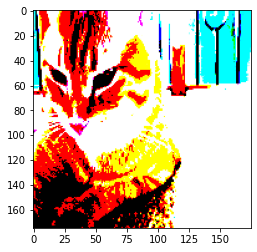

class name: chair
rank: 1084
predicted label: 0.98912513
true label: 1
Class name chair


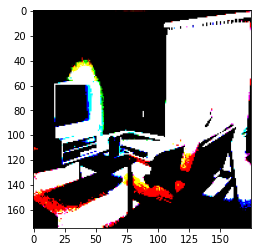

rank: 1400
predicted label: 0.9921599
true label: 1
Class name chair


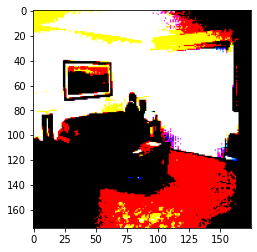

rank: 1788
predicted label: 0.9951296
true label: 1
Class name chair


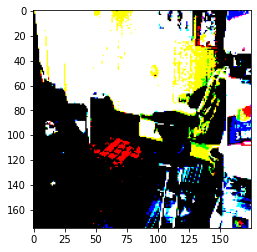

rank: 1369
predicted label: 0.9953269
true label: 1
Class name chair


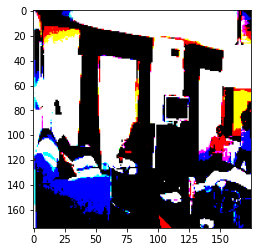

rank: 1827
predicted label: 0.9960296
true label: 1
Class name chair


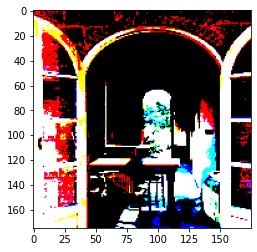

rank: 864
predicted label: 0.99617815
true label: 1
Class name chair


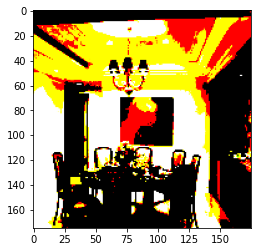

rank: 415
predicted label: 0.99652845
true label: 1
Class name chair


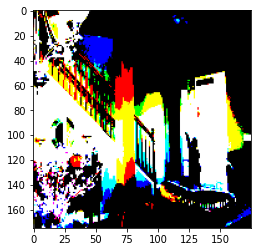

rank: 1667
predicted label: 0.99688846
true label: 1
Class name chair


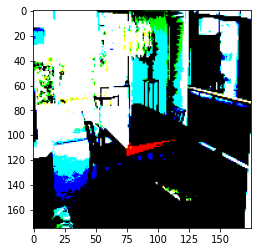

rank: 391
predicted label: 0.9970783
true label: 1
Class name chair


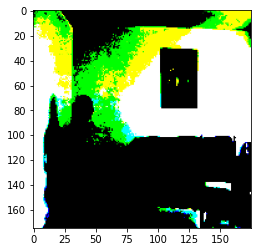

rank: 1881
predicted label: 0.99893874
true label: 1
Class name chair


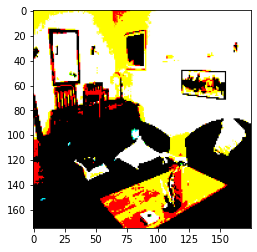

class name: cow
rank: 914
predicted label: 0.9617395
true label: 1
Class name cow


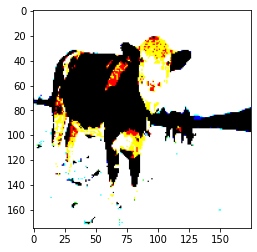

rank: 1141
predicted label: 0.962873
true label: 0
Class name cow


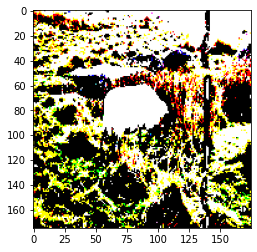

rank: 835
predicted label: 0.9681397
true label: 1
Class name cow


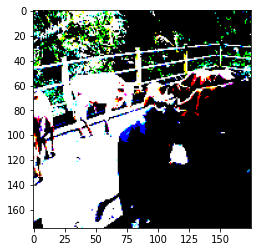

rank: 437
predicted label: 0.9728052
true label: 1
Class name cow


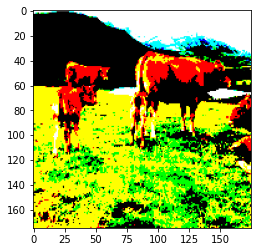

rank: 1327
predicted label: 0.98262966
true label: 0
Class name cow


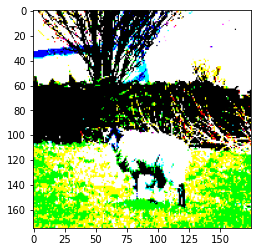

rank: 1255
predicted label: 0.9882025
true label: 1
Class name cow


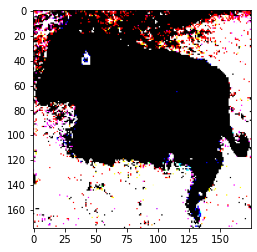

rank: 804
predicted label: 0.98943627
true label: 1
Class name cow


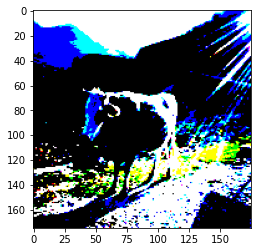

rank: 1269
predicted label: 0.99415874
true label: 0
Class name cow


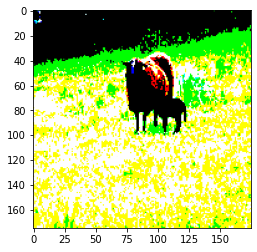

rank: 267
predicted label: 0.9963266
true label: 1
Class name cow


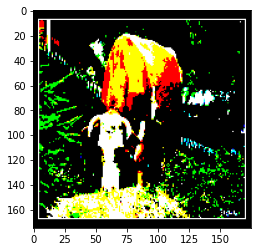

rank: 93
predicted label: 0.9982717
true label: 1
Class name cow


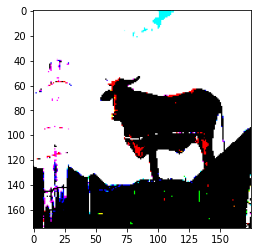

class name: diningtable
rank: 1630
predicted label: 0.98345137
true label: 1
Class name diningtable


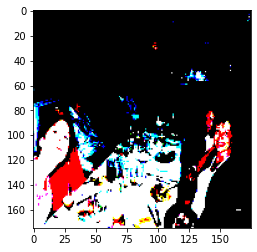

rank: 1217
predicted label: 0.98373413
true label: 1
Class name diningtable


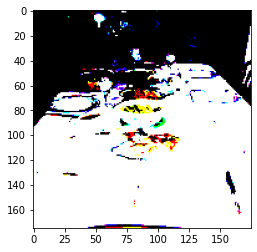

rank: 399
predicted label: 0.98412424
true label: 1
Class name diningtable


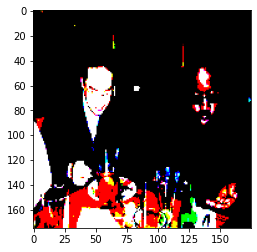

rank: 1239
predicted label: 0.98948294
true label: 0
Class name diningtable


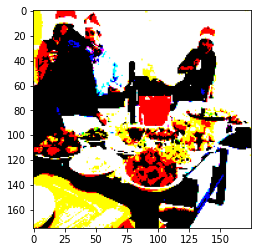

rank: 1631
predicted label: 0.9909894
true label: 1
Class name diningtable


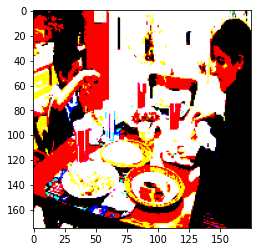

rank: 1005
predicted label: 0.99388087
true label: 1
Class name diningtable


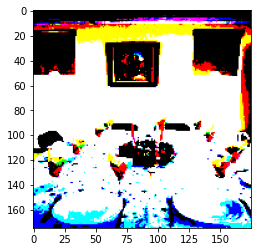

rank: 360
predicted label: 0.9953831
true label: 1
Class name diningtable


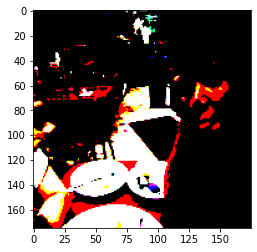

rank: 1402
predicted label: 0.9971722
true label: 1
Class name diningtable


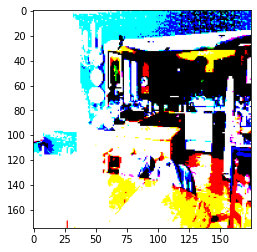

rank: 1755
predicted label: 0.99781704
true label: 1
Class name diningtable


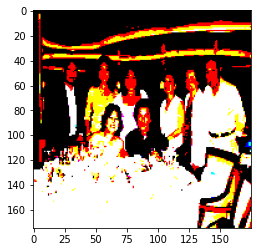

rank: 4
predicted label: 0.9991103
true label: 1
Class name diningtable


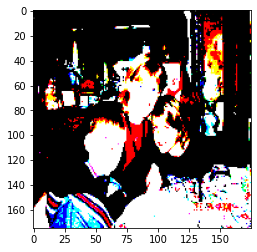

class name: dog
rank: 1920
predicted label: 0.99939036
true label: 1
Class name dog


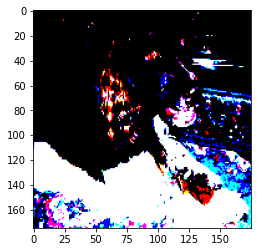

rank: 117
predicted label: 0.9994941
true label: 1
Class name dog


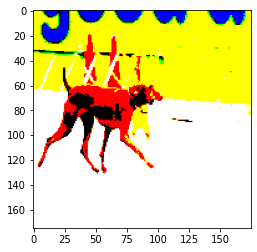

rank: 98
predicted label: 0.9995004
true label: 1
Class name dog


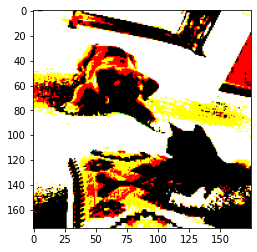

rank: 1305
predicted label: 0.9996282
true label: 1
Class name dog


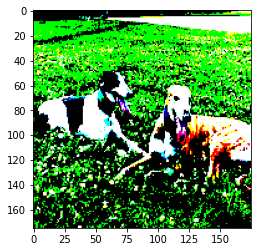

rank: 1329
predicted label: 0.9996828
true label: 1
Class name dog


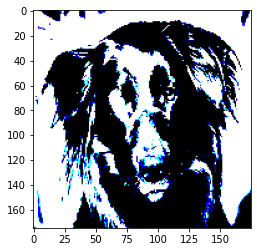

rank: 1387
predicted label: 0.9996953
true label: 1
Class name dog


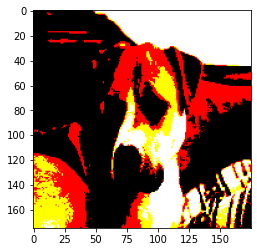

rank: 3
predicted label: 0.9997242
true label: 1
Class name dog


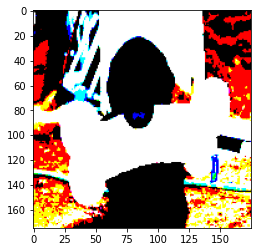

rank: 339
predicted label: 0.99982965
true label: 1
Class name dog


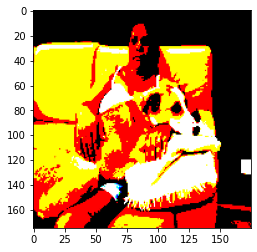

rank: 1669
predicted label: 0.9998797
true label: 1
Class name dog


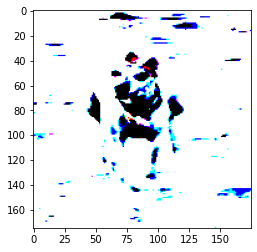

rank: 1617
predicted label: 0.99999607
true label: 1
Class name dog


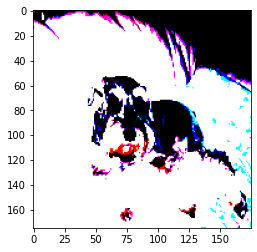

class name: horse
rank: 792
predicted label: 0.9994061
true label: 1
Class name horse


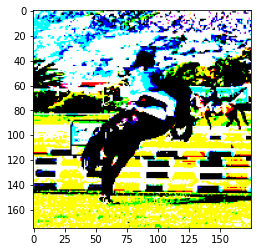

rank: 1310
predicted label: 0.9994167
true label: 1
Class name horse


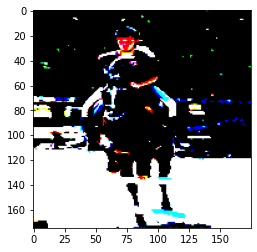

rank: 197
predicted label: 0.9994209
true label: 1
Class name horse


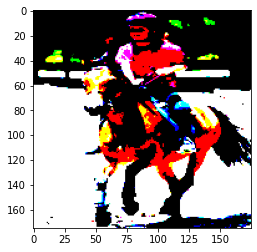

rank: 1863
predicted label: 0.99949956
true label: 1
Class name horse


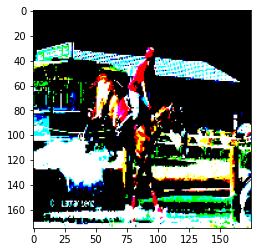

rank: 291
predicted label: 0.9997055
true label: 1
Class name horse


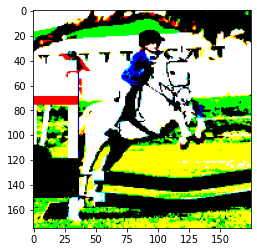

rank: 1723
predicted label: 0.9997589
true label: 1
Class name horse


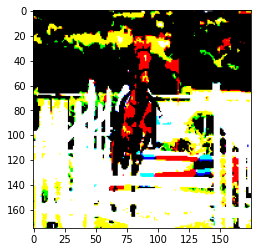

rank: 341
predicted label: 0.99981743
true label: 1
Class name horse


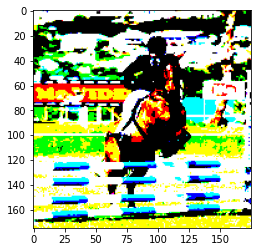

rank: 1775
predicted label: 0.999848
true label: 1
Class name horse


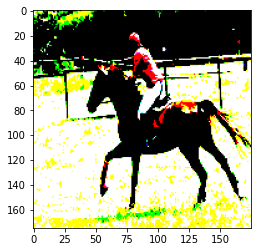

rank: 13
predicted label: 0.99998736
true label: 1
Class name horse


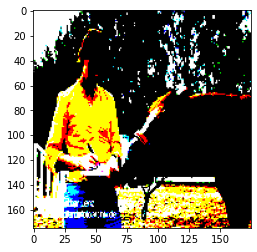

rank: 828
predicted label: 0.9999913
true label: 1
Class name horse


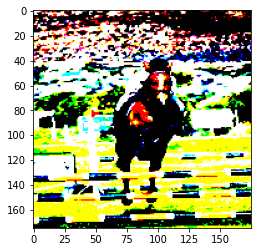

class name: motorbike
rank: 724
predicted label: 0.9997347
true label: 1
Class name motorbike


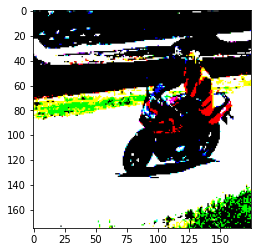

rank: 636
predicted label: 0.99974006
true label: 1
Class name motorbike


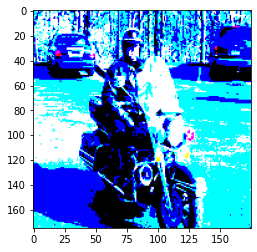

rank: 162
predicted label: 0.9998154
true label: 1
Class name motorbike


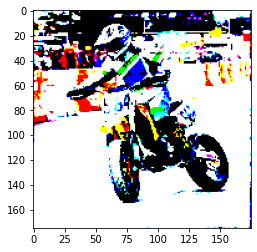

rank: 1903
predicted label: 0.99982256
true label: 1
Class name motorbike


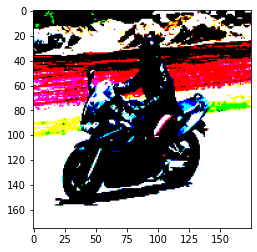

rank: 1946
predicted label: 0.9998456
true label: 1
Class name motorbike


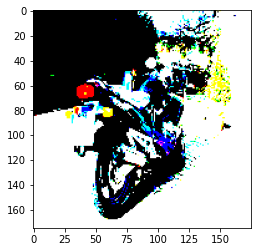

rank: 9
predicted label: 0.99994504
true label: 1
Class name motorbike


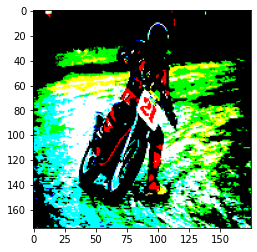

rank: 1925
predicted label: 0.99995995
true label: 1
Class name motorbike


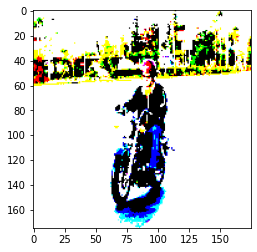

rank: 1814
predicted label: 0.99997854
true label: 1
Class name motorbike


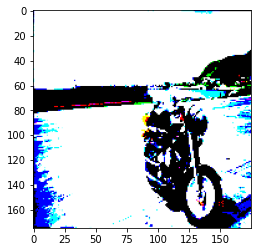

rank: 1437
predicted label: 0.99998415
true label: 1
Class name motorbike


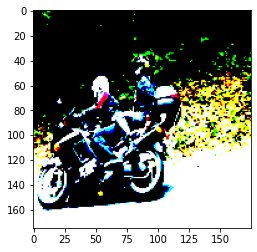

rank: 831
predicted label: 0.9999925
true label: 1
Class name motorbike


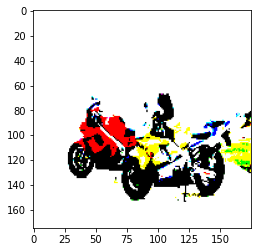

class name: person
rank: 1862
predicted label: 0.9999918
true label: 1
Class name person


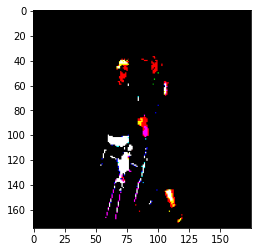

rank: 1467
predicted label: 0.99999297
true label: 1
Class name person


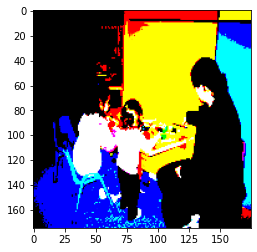

rank: 55
predicted label: 0.99999356
true label: 1
Class name person


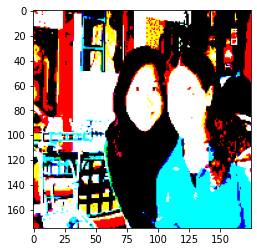

rank: 1165
predicted label: 0.9999939
true label: 1
Class name person


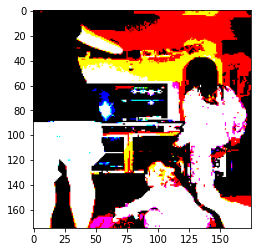

rank: 1328
predicted label: 0.99999464
true label: 1
Class name person


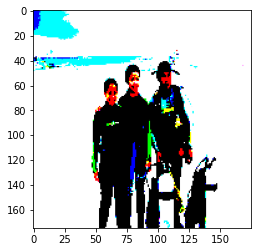

rank: 1088
predicted label: 0.9999958
true label: 1
Class name person


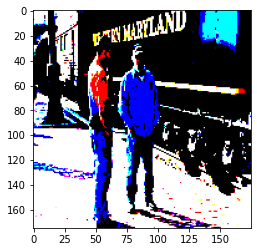

rank: 457
predicted label: 0.99999595
true label: 1
Class name person


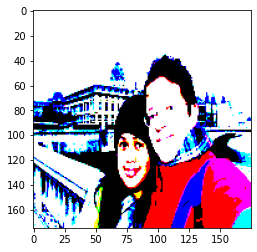

rank: 421
predicted label: 0.99999714
true label: 1
Class name person


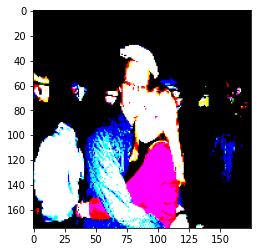

rank: 356
predicted label: 0.9999982
true label: 1
Class name person


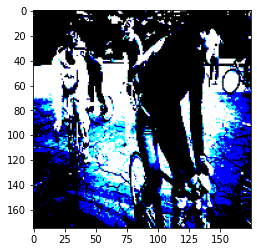

rank: 980
predicted label: 0.9999989
true label: 1
Class name person


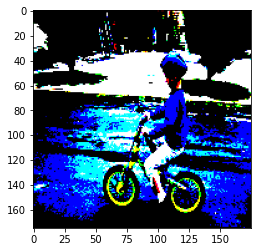

class name: pottedplant
rank: 205
predicted label: 0.92384166
true label: 0
Class name 

pottedplant


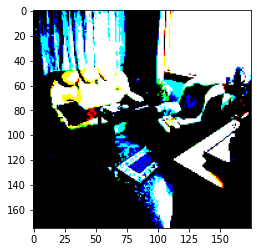

rank: 1519
predicted label: 0.95150554
true label: 1
Class name pottedplant


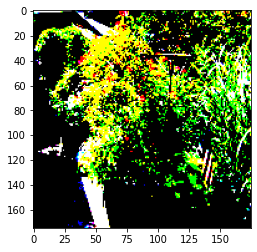

rank: 1538
predicted label: 0.95191044
true label: 1
Class name pottedplant


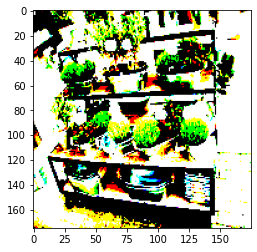

rank: 1674
predicted label: 0.9642861
true label: 1
Class name pottedplant


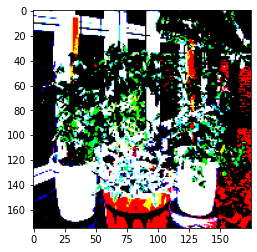

rank: 1850
predicted label: 0.97101116
true label: 1
Class name pottedplant


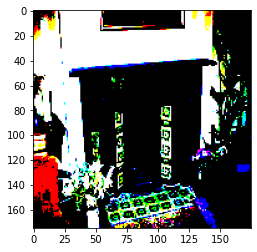

rank: 890
predicted label: 0.9793185
true label: 1
Class name pottedplant


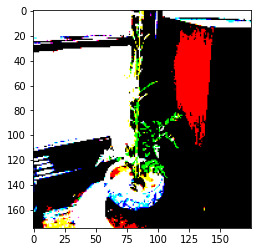

rank: 844
predicted label: 0.98521984
true label: 1
Class name pottedplant


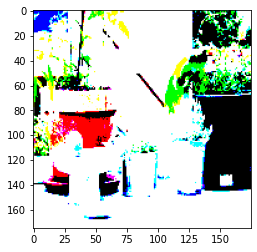

rank: 927
predicted label: 0.9882229
true label: 1
Class name pottedplant


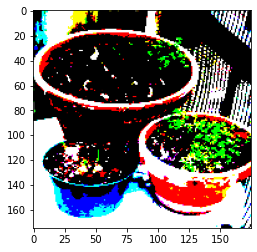

rank: 357
predicted label: 0.99029595
true label: 1
Class name pottedplant


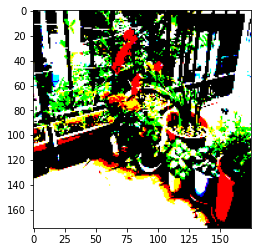

rank: 1944
predicted label: 0.99333715
true label: 1
Class name pottedplant


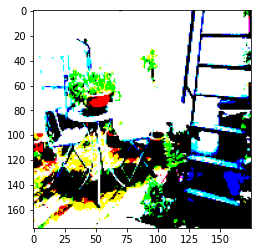

class name: sheep
rank: 907
predicted label: 0.98086643
true label: 1
Class name 

sheep


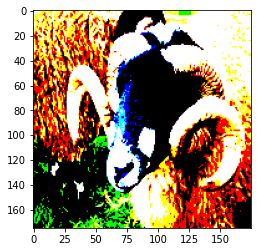

rank: 1545
predicted label: 0.98628706
true label: 0
Class name sheep


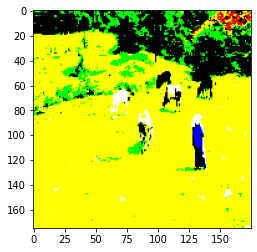

rank: 494
predicted label: 0.98927593
true label: 1
Class name sheep


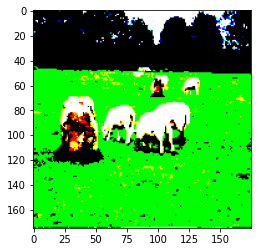

rank: 1141
predicted label: 0.9916707
true label: 1
Class name sheep


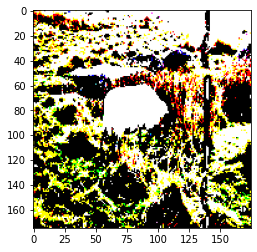

rank: 1269
predicted label: 0.9940838
true label: 1
Class name sheep


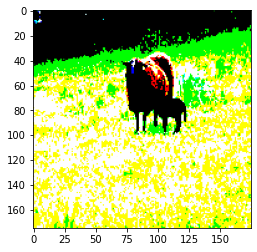

rank: 1632
predicted label: 0.99419737
true label: 1
Class name sheep


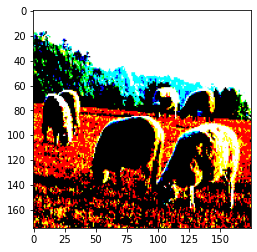

rank: 158
predicted label: 0.99436295
true label: 1
Class name sheep


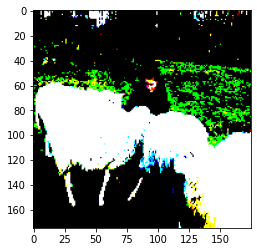

rank: 381
predicted label: 0.99673766
true label: 1
Class name sheep


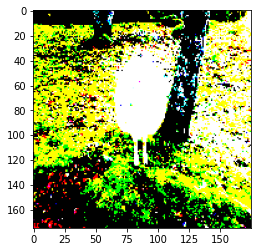

rank: 1327
predicted label: 0.9981553
true label: 1
Class name sheep


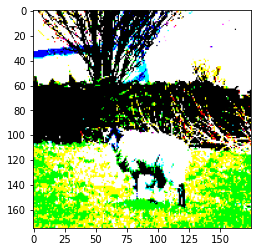

rank: 1469
predicted label: 0.9993788
true label: 1
Class name sheep


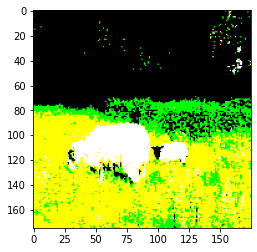

class name: sofa
rank: 582
predicted label: 0.97907764
true label: 1
Class name sofa


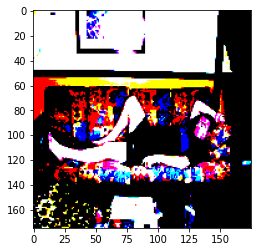

rank: 336
predicted label: 0.9794038
true label: 1
Class name sofa


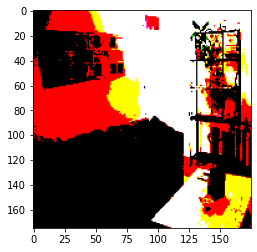

rank: 1535
predicted label: 0.9807757
true label: 1
Class name sofa


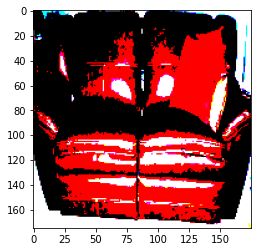

rank: 419
predicted label: 0.9829198
true label: 1
Class name sofa


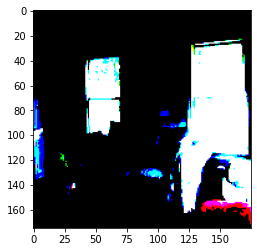

rank: 370
predicted label: 0.9841801
true label: 1
Class name sofa


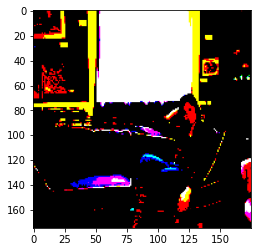

rank: 881
predicted label: 0.98671794
true label: 0
Class name sofa


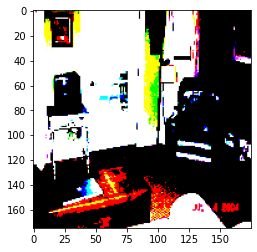

rank: 238
predicted label: 0.9869652
true label: 1
Class name sofa


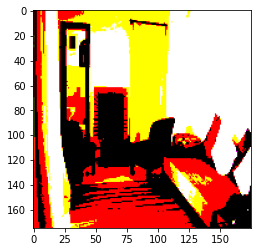

rank: 1772
predicted label: 0.9906585
true label: 1
Class name sofa


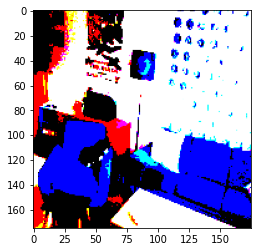

rank: 972
predicted label: 0.99307305
true label: 1
Class name sofa


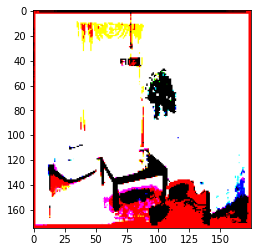

rank: 332
predicted label: 0.9977925
true label: 1
Class name sofa


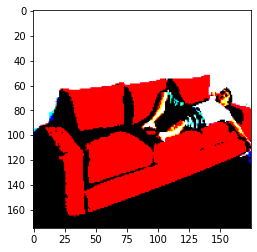

class name: train
rank: 86
predicted label: 0.99975365
true label: 1
Class name train


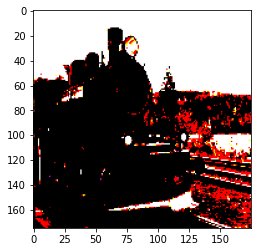

rank: 372
predicted label: 0.99981195
true label: 1
Class name train


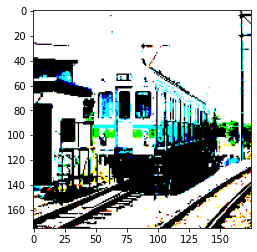

rank: 388
predicted label: 0.9999213
true label: 1
Class name train


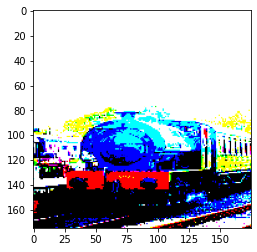

rank: 1297
predicted label: 0.99993753
true label: 1
Class name train


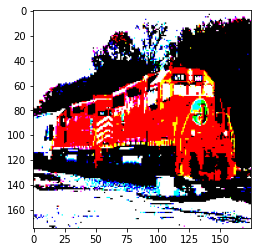

rank: 359
predicted label: 0.9999528
true label: 1
Class name train


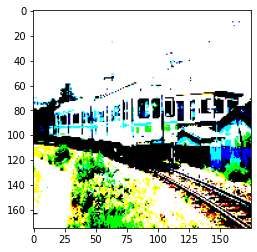

rank: 1076
predicted label: 0.9999627
true label: 1
Class name train


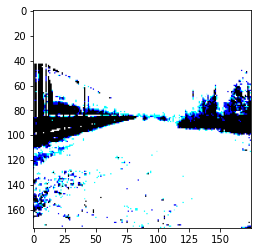

rank: 1304
predicted label: 0.9999738
true label: 1
Class name train


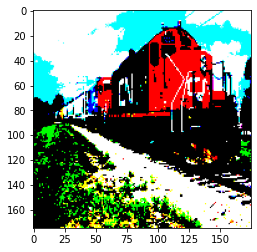

rank: 1290
predicted label: 0.99997616
true label: 1
Class name train


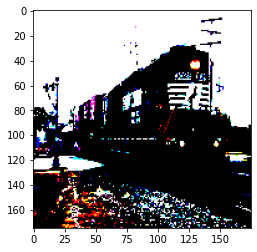

rank: 613
predicted label: 0.99998677
true label: 1
Class name train


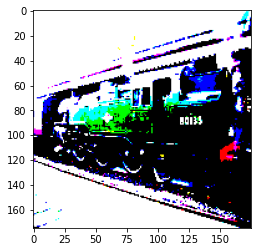

rank: 183
predicted label: 0.9999958
true label: 1
Class name train


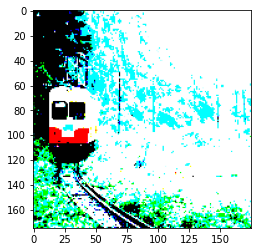

class name: tvmonitor
rank: 572
predicted label: 0.97563756
true label: 1
Class name tvmonitor


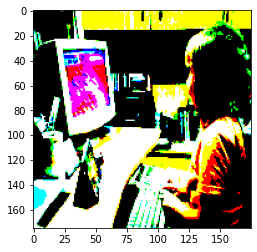

rank: 1497
predicted label: 0.97658736
true label: 1
Class name tvmonitor


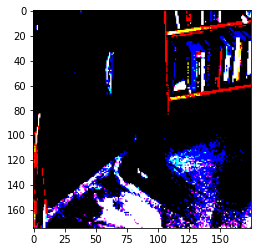

rank: 482
predicted label: 0.9825188
true label: 1
Class name tvmonitor


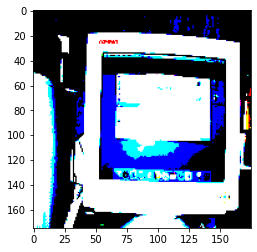

rank: 1573
predicted label: 0.98482794
true label: 1
Class name tvmonitor


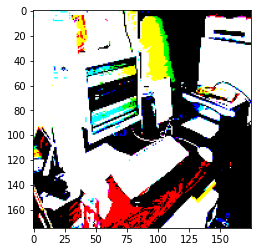

rank: 135
predicted label: 0.98744035
true label: 1
Class name tvmonitor


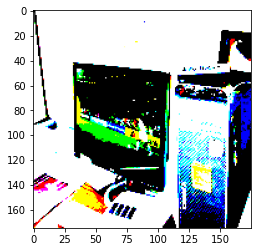

rank: 243
predicted label: 0.9909147
true label: 1
Class name tvmonitor


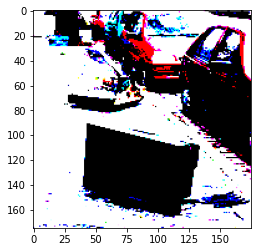

rank: 656
predicted label: 0.9946391
true label: 1
Class name tvmonitor


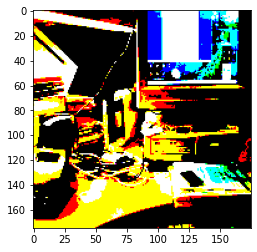

rank: 306
predicted label: 0.99723756
true label: 1
Class name tvmonitor


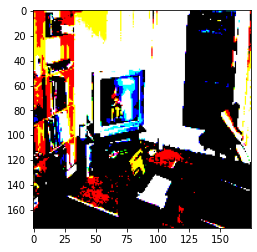

rank: 604
predicted label: 0.9982798
true label: 1
Class name tvmonitor


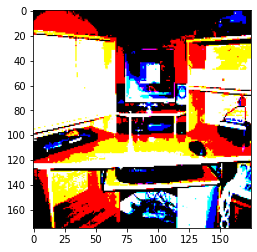

rank: 926
predicted label: 0.9983265
true label: 1
Class name tvmonitor


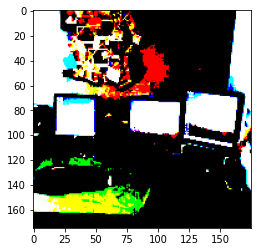

In [ ]:
# show the top 10 ranked photos for each class

def show_top10_ranked_photos(X_test, y_test, y_pred, class_names):
    y_pred = np.asarray(y_pred)
    y_test = np.asarray(y_test)
    X_test = np.asarray(X_test)
    print("X_test shape:", X_test.shape)
    print("y_test shape:", y_test.shape)
    print("y_pred shape:", y_pred.shape)
    print("class_names shape:", len(class_names))
    for i in range(20):
        print("class name:", class_names[i])
        # get the top 10 ranked photos
        top10 = np.argsort(y_pred[:, i])[-10:]
        for j in top10:
            print("rank:", j)
            print("predicted label:", y_pred[j, i])
            print("true label:", y_test[j, i])
            print("Class name", class_names[i])
            plt.imshow(X_test[j])
            plt.show()

show_top10_ranked_photos(X_test, y_test, y_pred, class_names)

# Discussion

* Applied three different Pre-trained models on PASCAL VOC Dataset(2007)
* Hyperparameters are kept same for all models
* Comparison of all three models is shown in below table:


| Pre-Trained model | Epochs | Test-Accuracy | MAP |
| --- | --- | --- | ---|
| Inception_V3 | 20 | 12.45% | 0.1059 |
| VGG-16 | 20 | 53.00% | 0.45 |
| ResNet-50 | 20 | 59.40% | 0.48 |

* From the results shown in the table it is very clear that performance of Inception_v3 model is very low on PASCAL VOC Dataset.
* ResNet-50 model outperforms on rest models.